# Introduction

## About the dataset:
This dataset contains information on default payments, demographic factors, credit data, history of payment, and bill statements of credit card clients in Taiwan from April 2005 to September 2005. 

## Features:
There are 25 features:

* ID: ID of each client
* LIMIT_BAL: Amount of given credit in NT dollars (includes individual and family/supplementary credit
* SEX: Gender (1=male, 2=female)
* EDUCATION: (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)
* MARRIAGE: Marital status (1=married, 2=single, 3=others)
* AGE: Age in years
* PAY_0: Repayment status in September, 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, ... 8=payment delay for eight months, 9=payment delay for nine months and above)
* PAY_2: Repayment status in August, 2005 (scale same as above)
* PAY_3: Repayment status in July, 2005 (scale same as above)
* PAY_4: Repayment status in June, 2005 (scale same as above)
* PAY_5: Repayment status in May, 2005 (scale same as above)
* PAY_6: Repayment status in April, 2005 (scale same as above)
* BILL_AMT1: Amount of bill statement in September, 2005 (NT dollar)
* BILL_AMT2: Amount of bill statement in August, 2005 (NT dollar)
* BILL_AMT3: Amount of bill statement in July, 2005 (NT dollar)
* BILL_AMT4: Amount of bill statement in June, 2005 (NT dollar)
* BILL_AMT5: Amount of bill statement in May, 2005 (NT dollar)
* BILL_AMT6: Amount of bill statement in April, 2005 (NT dollar)
* PAY_AMT1: Amount of previous payment in September, 2005 (NT dollar)
* PAY_AMT2: Amount of previous payment in August, 2005 (NT dollar)
* PAY_AMT3: Amount of previous payment in July, 2005 (NT dollar)
* PAY_AMT4: Amount of previous payment in June, 2005 (NT dollar)
* PAY_AMT5: Amount of previous payment in May, 2005 (NT dollar)
* PAY_AMT6: Amount of previous payment in April, 2005 (NT dollar)
* default.payment.next.month: Default payment (1=yes, 0=no)

## Overview:

We've used our skills like data cleaning, data analysis, data visualization and machine learning. We hope to carry out a research and to build several ML models to predict defaulters of credit card payments and compare their performance.

This notebook consisits of the following parts:

1) Exploratory Data Analysis

2) Data cleaning and further exploration

3) Building a base model

4) Feature Engineering

5) Building ML model using various algorithms and comparing them

6) Conclusion



# Importation of Libraries

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier
from sklearn.svm import SVC
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import scorecardpy as sc
import plotly.io as pio
pio.templates.default = "plotly_dark"

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from scipy.stats import uniform as sp_uniform
from sklearn.metrics import make_scorer, cohen_kappa_score, accuracy_score
import scipy
QUADRATIC_WEIGHT_SCORER = make_scorer(cohen_kappa_score, weights='quadratic')


%matplotlib inline
pd.set_option('display.max_columns',None)
sns.set(style="darkgrid", palette="pastel", color_codes=True)
sns.set_context('paper')

import plotly.graph_objs as go
from plotly.subplots import make_subplots

from sklearn.utils import resample 
from imblearn.over_sampling import SMOTE
from sklearn.feature_selection import RFE,SelectFromModel
from sklearn.model_selection import KFold,GridSearchCV,RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline 
from sklearn.naive_bayes import GaussianNB
from scipy.stats import randint as sp_randint
from sklearn.ensemble import RandomForestClassifier ,ExtraTreesClassifier, AdaBoostClassifier,GradientBoostingClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.feature_selection import RFECV
from sklearn.metrics import classification_report,confusion_matrix,f1_score,roc_auc_score,roc_curve,accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
import plotly.figure_factory as ff 

import warnings
warnings.filterwarnings("ignore")

import random
random.seed(10)


# Reading the csv file and dropping the ID feature

In [22]:
df = pd.read_csv('C:/Users/MOFEOLUWA/Desktop/UCI_Credit_Card.csv')
df = df.drop('ID', axis=1)

# Exploratory data analysis

In [23]:
# see the first five rows
df.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,20000.0,2,2,1,24,2,2,-1,-1,-2,-2,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,120000.0,2,2,2,26,-1,2,0,0,0,2,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,90000.0,2,2,2,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,50000.0,2,2,1,37,0,0,0,0,0,0,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,50000.0,1,2,1,57,-1,0,-1,0,0,0,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [6]:
# As the first step, find out if there are missing or anomalous data.
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
LIMIT_BAL                     30000 non-null float64
SEX                           30000 non-null int64
EDUCATION                     30000 non-null int64
MARRIAGE                      30000 non-null int64
AGE                           30000 non-null int64
PAY_0                         30000 non-null int64
PAY_2                         30000 non-null int64
PAY_3                         30000 non-null int64
PAY_4                         30000 non-null int64
PAY_5                         30000 non-null int64
PAY_6                         30000 non-null int64
BILL_AMT1                     30000 non-null float64
BILL_AMT2                     30000 non-null float64
BILL_AMT3                     30000 non-null float64
BILL_AMT4                     30000 non-null float64
BILL_AMT5                     30000 non-null float64
BILL_AMT6                     30000 non-null float64
PAY_AMT1  

In [24]:
# Let's rename the target column to "default" and payment status "PAY_0" to "PAY_1" to make it consecutive

df = df.rename(columns={'default.payment.next.month': 'default', 
                        'PAY_0': 'PAY_1'})

Text(0, 0.5, 'Number')

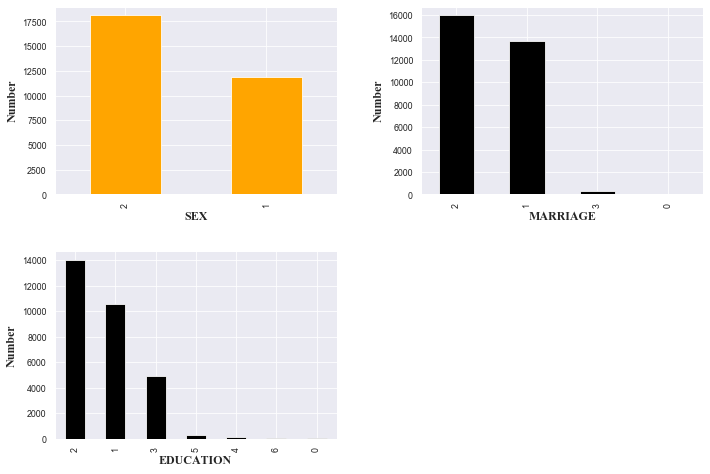

In [8]:
# Visualization of the Categorical features (Marriage, Sex, Education)


plt.subplots_adjust(left = 0, bottom = 0, right = 1.5, top = 1.5, wspace = 0.3, hspace = 0.3)
font = {'family' : 'Times New Roman', 'weight' : 'normal', 'size' : 12}

plt.subplot(2, 2, 1)
df.SEX.value_counts().plot(kind = 'bar', color='orange',alpha=1.0)
plt.xlabel("SEX", font)
plt.ylabel("Number", font)

plt.subplot(2, 2, 2)
df.MARRIAGE.value_counts().plot(kind = 'bar',color='black',alpha=1.0)
plt.xlabel("MARRIAGE", font)
plt.ylabel("Number", font)

plt.subplot(2, 2, 3)
df.EDUCATION.value_counts().plot(kind = 'bar',color='black',alpha=1.0)
plt.xlabel("EDUCATION", font)
plt.ylabel("Number", font)

1.) Marriage has label 0, which is undocumented

2.) It seems that there are more number of female customers

3.) Education has label 0 ,label 5 & label 6, which are undocumented. Also most of the customers are well educated!

NEXT

Visualization of the Numerical variables: (Bill amount,Previous payment,Previous payment status,Age,Amount given in credit)

we'll be using plotly for better visualization

In [9]:
#  bill amount

bills = df[['BILL_AMT1','BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6']]

fig = make_subplots(rows= 3, cols=2,subplot_titles=bills.columns.to_list())  

fig.add_trace(go.Histogram(x= df["BILL_AMT1"],name='BILL_AMT1'),row = 1, col = 1)
fig.add_trace(go.Histogram(x= df["BILL_AMT2"],name='BILL_AMT2'),row = 2, col = 2)
fig.add_trace(go.Histogram(x= df["BILL_AMT3"],name='BILL_AMT3'),row = 3, col = 1)
fig.add_trace(go.Histogram(x= df["BILL_AMT4"],name='BILL_AMT4'),row = 1, col = 2)
fig.add_trace(go.Histogram(x= df["BILL_AMT5"],name='BILL_AMT5'),row = 2, col = 1)
fig.add_trace(go.Histogram(x= df["BILL_AMT6"],name='BILL_AMT6'),row = 3, col = 2)


fig.update_layout(height=600, width=800, title_text="Histogram Subplots of Bill Amount")
fig.show()

In [10]:
# pay amount (previous payment)

pay = df[['PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']]

fig = make_subplots(rows= 3, cols=2,subplot_titles=pay.columns.to_list())  

fig.add_trace(go.Histogram(x= df["PAY_AMT1"],name='PAY_AMT1'),row = 1, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_AMT2"],name='PAY_AMT2'),row = 2, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_AMT3"],name='PAY_AMT3'),row = 3, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_AMT4"],name='PAY_AMT4'),row = 1, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_AMT5"],name='PAY_AMT5'),row = 2, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_AMT6"],name='PAY_AMT6'),row = 3, col = 2)


fig.update_layout(height=600, width=800, title_text="Histogram Subplots of Amount of Previous Payment")
fig.show()

In [11]:
# previous payment status


pay_s = df[['PAY_1','PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6']]
df['PAY_1'].value_counts().index.to_list().sort()

fig = make_subplots(rows= 3, cols=2,subplot_titles=pay_s.columns.to_list())  

fig.add_trace(go.Histogram(x= df["PAY_1"],name='PAY_1'),row = 1, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_2"],name='PAY_2'),row = 2, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_3"],name='PAY_3'),row = 3, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_4"],name='PAY_4'),row = 1, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_5"],name='PAY_5'),row = 2, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_6"],name='PAY_6'),row = 3, col = 2)


fig.update_layout(bargap=0.2,height=600, width=800, title_text="Histogram Subplots of Previous Payment Status")
fig.show()


From the above;

There are a lot of customers who pay The previous amount duly but there are only some of them who pay late

In [12]:
# Age

fig =  go.Figure(data=[go.Histogram(x= df["AGE"])])
fig.show()

Looking at the distribution, it's clear that there are more people who are aged between 20-30 and it goes on decreasing after 30. 

It is also a bit right skewed

In [13]:
# Amount given in credit


fig =  go.Figure(data=[go.Histogram(x= df["LIMIT_BAL"])])
fig.show()

More of the people have taken credit between 10k to 400k.

In [14]:
# Target column (Default)


target_count = df['default'].value_counts().reset_index().rename(columns={'index':'index','default':'count'})
fig = go.Figure(go.Bar(
    x = target_count['index'],y = target_count['count'],text=target_count['count'],marker={'color': target_count['count']}
    ,textposition = "outside"))
fig.update_layout(title_text='Count plot of defaulter',xaxis_title="Status of Defaulting",yaxis_title="Number of count")
fig.show()

The data has a large imbalance with respect of the target value (default).

This would be addressed later

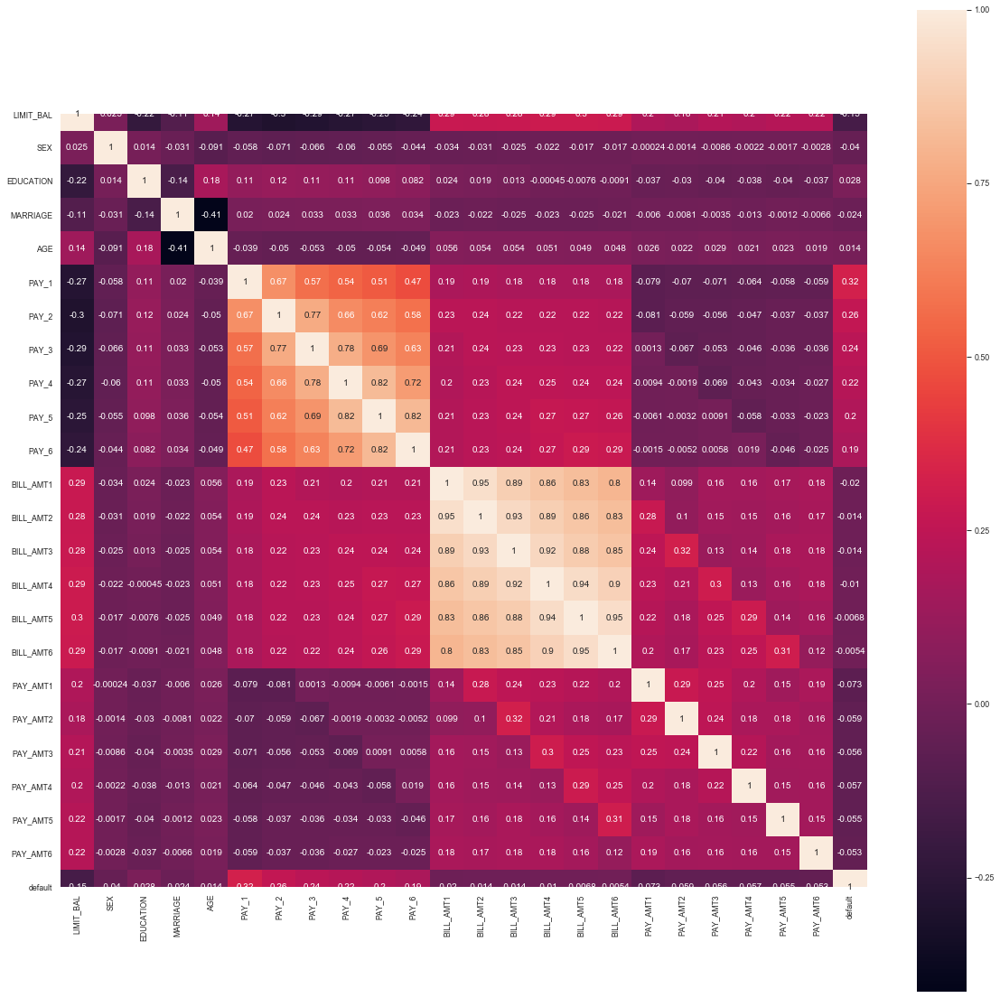

In [15]:
# Correlation

plt.figure(figsize = (20,20))
sns.heatmap(df.corr(),annot = True,square = True)

The heatmap shows that features are correlated with each other (collinearity), such like PAY_0,2,3,4,5,6 and BILL_AMT1,2,3,4,5,6.

In those cases, the correlation is positive.

# Data cleaning and further exploration

It was pointed out earlier that there are some undocumented labels. we will carry out the data cleaning here.

The 0 (undocumented), 5 and 6 (label unknown) in EDUCATION can also be put in a 'Other' category (thus 4)

In [25]:
fil = (df.EDUCATION == 5) | (df.EDUCATION == 6) | (df.EDUCATION == 0)
df.loc[fil, 'EDUCATION'] = 4
df.EDUCATION.value_counts()

2    14030
1    10585
3     4917
4      468
Name: EDUCATION, dtype: int64

In [26]:
# The 0 in MARRIAGE can be safely categorized as 'Other' (thus 3)

df.loc[df.MARRIAGE == 0, 'MARRIAGE'] = 3
df.MARRIAGE.value_counts()

2    15964
1    13659
3      377
Name: MARRIAGE, dtype: int64

Text(0, 0.5, 'Number')

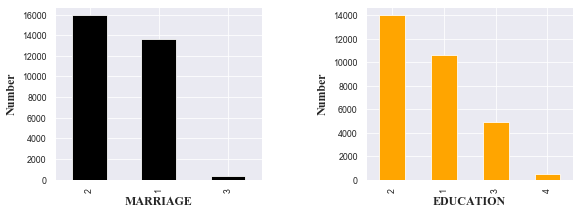

In [18]:
# We take a look at their distribution again.

plt.subplots_adjust(left = 0, bottom = 0, right = 1.2, top = 0.6, wspace = 0.5, hspace = 0.5)

plt.subplot(1, 2, 1)
df.MARRIAGE.value_counts().plot(kind = 'bar',color='black')
plt.xlabel("MARRIAGE", font)
plt.ylabel("Number", font)

plt.subplot(1, 2, 2)
df.EDUCATION.value_counts().plot(kind = 'bar',color='orange')
plt.xlabel("EDUCATION", font)
plt.ylabel("Number", font)

"-1" is paid duly, but there are "-2" and "0" labels in payment status variable. 

So let's combine them and put everything as "0"

In [27]:

fil = (df.PAY_1 == -2) | (df.PAY_1 == -1) | (df.PAY_1 == 0)
df.loc[fil, 'PAY_1'] = 0
fil = (df.PAY_2 == -2) | (df.PAY_2 == -1) | (df.PAY_2 == 0)
df.loc[fil, 'PAY_2'] = 0
fil = (df.PAY_3 == -2) | (df.PAY_3 == -1) | (df.PAY_3 == 0)
df.loc[fil, 'PAY_3'] = 0
fil = (df.PAY_4 == -2) | (df.PAY_4 == -1) | (df.PAY_4 == 0)
df.loc[fil, 'PAY_4'] = 0
fil = (df.PAY_5 == -2) | (df.PAY_5 == -1) | (df.PAY_5 == 0)
df.loc[fil, 'PAY_5'] = 0
fil = (df.PAY_6 == -2) | (df.PAY_6 == -1) | (df.PAY_6 == 0)
df.loc[fil, 'PAY_6'] = 0

In [20]:
# Histogram after clubbing "-2" and "-1" to "0" label

fig = make_subplots(rows= 3, cols=2,subplot_titles=pay_s.columns.to_list())  

fig.add_trace(go.Histogram(x= df["PAY_1"],name='PAY_1'),row = 1, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_2"],name='PAY_2'),row = 2, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_3"],name='PAY_3'),row = 3, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_4"],name='PAY_4'),row = 1, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_5"],name='PAY_5'),row = 2, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_6"],name='PAY_6'),row = 3, col = 2)


fig.update_layout(bargap=0.2,height=600, width=800, title_text="Histogram Subplots of Previous Payment Status (After clubbing)")
fig.show()

We no longer have -1 and -2 present in the histogram plot we see

# Baseline models


A baseline model uses heuristics(not optimal or perfect) but sufficient, simple summary statistics, randomness, or machine learning to create predictions for a dataset. You can use these predictions to measure the baseline's performance (e.g., accuracy)-- this metric will then become what you compare any other machine learning algorithm against. So let's build a few classifiers without any hyperparameter tuning or feature engineering.

In [21]:
X = df.drop('default', axis=1)  
y = df['default']

# we split our dataset into 70:30

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=42,stratify=y)

In [28]:
random = RandomForestClassifier()
LR = LogisticRegression(random_state=0)
xgb = XGBClassifier()
catboost = CatBoostClassifier()
lgbm = LGBMClassifier()
svm = SVC()

In [23]:
# A function that returns the accuracy score, classification report, confusion matrix

def report(model,x_train,x_test,y_train,y_test):
    model.fit(x_train,y_train)
    y_pred = model.predict(x_test)
    print('accuracy score:',accuracy_score(y_test,y_pred))
    print('classification report:','\n',classification_report(y_test,y_pred))
    print('confusion matrix:','\n',confusion_matrix(y_test,y_pred))

In [24]:
# result for losgistic regression

report(LR,X_train,X_test,y_train,y_test)

accuracy score: 0.7787777777777778
classification report: 
               precision    recall  f1-score   support

           0       0.78      1.00      0.88      7009
           1       0.00      0.00      0.00      1991

    accuracy                           0.78      9000
   macro avg       0.39      0.50      0.44      9000
weighted avg       0.61      0.78      0.68      9000

confusion matrix: 
 [[7009    0]
 [1991    0]]


In [25]:
# result for xgboost

report(xgb,X_train,X_test,y_train,y_test)


accuracy score: 0.8182222222222222
classification report: 
               precision    recall  f1-score   support

           0       0.84      0.95      0.89      7009
           1       0.67      0.36      0.46      1991

    accuracy                           0.82      9000
   macro avg       0.75      0.65      0.68      9000
weighted avg       0.80      0.82      0.80      9000

confusion matrix: 
 [[6656  353]
 [1283  708]]


In [26]:
# result for random forest

report(random,X_train,X_test,y_train,y_test)

accuracy score: 0.8017777777777778
classification report: 
               precision    recall  f1-score   support

           0       0.83      0.94      0.88      7009
           1       0.60      0.31      0.41      1991

    accuracy                           0.80      9000
   macro avg       0.71      0.63      0.65      9000
weighted avg       0.78      0.80      0.78      9000

confusion matrix: 
 [[6596  413]
 [1371  620]]


In [27]:
# result for catboost

report(catboost,X_train,X_test,y_train,y_test)


Learning rate set to 0.037803
0:	learn: 0.6713098	total: 267ms	remaining: 4m 26s
1:	learn: 0.6514014	total: 284ms	remaining: 2m 21s
2:	learn: 0.6333156	total: 305ms	remaining: 1m 41s
3:	learn: 0.6167472	total: 322ms	remaining: 1m 20s
4:	learn: 0.6020074	total: 336ms	remaining: 1m 6s
5:	learn: 0.5881185	total: 353ms	remaining: 58.4s
6:	learn: 0.5755062	total: 366ms	remaining: 52s
7:	learn: 0.5643140	total: 390ms	remaining: 48.4s
8:	learn: 0.5534249	total: 405ms	remaining: 44.6s
9:	learn: 0.5438774	total: 442ms	remaining: 43.7s
10:	learn: 0.5345416	total: 462ms	remaining: 41.6s
11:	learn: 0.5260991	total: 486ms	remaining: 40s
12:	learn: 0.5183237	total: 502ms	remaining: 38.1s
13:	learn: 0.5112150	total: 535ms	remaining: 37.7s
14:	learn: 0.5049679	total: 554ms	remaining: 36.4s
15:	learn: 0.4990400	total: 588ms	remaining: 36.1s
16:	learn: 0.4937124	total: 610ms	remaining: 35.3s
17:	learn: 0.4887247	total: 646ms	remaining: 35.3s
18:	learn: 0.4843348	total: 666ms	remaining: 34.4s
19:	learn: 

In [28]:
# result for light gbm

report(lgbm,X_train,X_test,y_train,y_test)


accuracy score: 0.8177777777777778
classification report: 
               precision    recall  f1-score   support

           0       0.84      0.95      0.89      7009
           1       0.66      0.36      0.47      1991

    accuracy                           0.82      9000
   macro avg       0.75      0.66      0.68      9000
weighted avg       0.80      0.82      0.80      9000

confusion matrix: 
 [[6636  373]
 [1267  724]]


In [29]:
# result for svc

report(svm,X_train,X_test,y_train,y_test)

accuracy score: 0.7794444444444445
classification report: 
               precision    recall  f1-score   support

           0       0.78      1.00      0.88      7009
           1       0.58      0.01      0.02      1991

    accuracy                           0.78      9000
   macro avg       0.68      0.50      0.45      9000
weighted avg       0.74      0.78      0.69      9000

confusion matrix: 
 [[6994   15]
 [1970   21]]


So the classifiers made use of, had accuracy scores of 0.805, 0.779, 0.818, 0.817, 0.818 and 0.779. We have to better this with parameter tuning and feature engineering.

# Feature Engineering

To begin with, all the categorical features (sex, marriage, education were one hot encoded. 

The one-hot encoding allows the representation of categorical data to be more expressive.


# Variance reduction between data points

Next, the variance between data points in the pay-amounts and limit balance were reduced in one instance and were not reduced in the second instance. This was done to evaluate the effect of variance on the performance of a model.

Furthermore, we had observed earlier the imbalance in the samples from the count plot of the target column.

We split the dataset in the ratio 70:30 for the train and test sets

Then we created the training data frame by remerging X_train and y_train.
                                             
In the train dataset, we observed the distribution of the samples and the imbalance in the samples was confirmed.


# Imbalance in samples

Due to the imbalance in the samples, we decided to take on a method called resampling.

WE carried out three types of resampling namely: Random Oversampling, Random Under sampling and the SMOTE technique.
	
1.) Random Oversampling: Randomly duplicate examples in the minority class and adds them to the training dataset. The           examples from the training dataset are selected randomly with replacement.

2.) Random Under sampling: Randomly selecting examples from the majority class to delete from the training dataset. This       process can be repeated until the desired class distribution is achieved, such as an equal number of examples for each     class.

3.) SMOTE (Synthetic Minority Oversampling Technique) : is an oversampling method which creates synthetic samples from the     minority class instead of creating copies. It selects 2 or more similar instances and perturb them one at a time by       random amount. 

In [29]:
df[['SEX','MARRIAGE','EDUCATION']] = df[['SEX','MARRIAGE','EDUCATION']].astype('object')

#One Hot encoding

df = pd.get_dummies(df)
df.head()

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3
0,20000.0,24,2,2,0,0,0,0,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1,0,1,0,1,0,0,1,0,0
1,120000.0,26,0,2,0,0,0,2,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1,0,1,0,1,0,0,0,1,0
2,90000.0,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0,0,1,0,1,0,0,0,1,0
3,50000.0,37,0,0,0,0,0,0,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0,0,1,0,1,0,0,1,0,0
4,50000.0,57,0,0,0,0,0,0,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0,1,0,0,1,0,0,1,0,0


Our final dataset is finished, let's split the dataset in 70:30 ratio for train and test. This is the dataset without the reduction of variance.


In [15]:

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, stratify=y, random_state=42)

In [16]:
# create the training df by remerging X_train and y_train

df_train = X_train.join(y_train)

 We have observed that there is imbalance in the samples from the countplot of the default column above.
 Let's see the distribution of the samples in the train dataset

In [17]:

# Separate majority and minority classes
df_majority = df_train[df_train.default == 0]
df_minority = df_train[df_train.default == 1]

print(df_train.default.value_counts())

0    16355
1     4645
Name: default, dtype: int64


A.) Random Oversampling

In [18]:

# Upsample minority class
df_minority_upsampled = resample(df_minority, 
                                 replace=True,     # sample with replacement
                                 n_samples = 16355,    # to match majority class
                                 random_state= 42) # reproducible results
# Combine majority class with upsampled minority class
df_upsampled = pd.concat([df_majority, df_minority_upsampled])
# Display new class counts
df_upsampled.default.value_counts()

1    16355
0    16355
Name: default, dtype: int64

B) Random Undersampling:

In [19]:
# Downsample majority class
df_majority_downsampled = resample(df_majority, 
                                 replace=False,    # sample without replacement
                                 n_samples=4645,     # to match minority class
                                 random_state=587) # reproducible results
# Combine minority class with downsampled majority class
df_downsampled = pd.concat([df_majority_downsampled, df_minority])
# Display new class counts
df_downsampled.default.value_counts()

1    4645
0    4645
Name: default, dtype: int64

C) SMOTE: Synthetic Minority Oversampling Technique

In [20]:
df_smote,smote_ytrain = SMOTE(random_state=42).fit_sample(X_train,y_train)
df_smote = pd.DataFrame(data=df_smote,columns= list(X_train.columns), dtype=None, copy=False)
smote_ytrain = pd.Series(smote_ytrain)
len(df_smote)

32710

So we now have four sets of training data:


1) The normal train data with unbalance

2) Train data with oversampling

3) Train data with undersampling

4) Train data with SMOTE algorithm


# Building ML model using various algorithms and comparing them


On the training datasets the following classifiers were explored:

Logistic Regression

Random forest classifier

XGboost classifier

CATBoost classifier


# Basis for Selecting the Best Classifier


Recall score and accuracy score would be the basis for choosing    the best classifier.

The recall is the ability of the classifier to find all the positive samples.

The recall score for 1 would be the priority. The recall score should not be less than 0.5.

The accuracy score should be above 77%. This is because the zeros are 77% of the target column of the dataset.

The ROC_AUC_Score (Receiver Opereating Characteristics, Area Under the ROC curve) is another basis for choosing the best classifier. It tells how much a model is capable of distinguishing between classes. Higher the AUC, better the model is at predicting 0s as 0s and 1s as 1s.


First let's define a function which evaluates the model with train and test score and also performs a K-fold cross validation on the train dataset


In [30]:
def model_eval(algo, Xtrain,ytrain,Xtest,ytest):
    from sklearn.metrics import confusion_matrix,accuracy_score,roc_auc_score,roc_curve,classification_report

    algo.fit(Xtrain,ytrain)
    y_pred = algo.predict(Xtrain)
    y_train_prob = algo.predict_proba(Xtrain)[:,1]

    #print('confusion matrix-train\n',confusion_matrix(ytrain,y_pred))
    print('Overall Train Accuracy',accuracy_score(ytrain,y_pred))
    print('Train AUC Score',roc_auc_score(ytrain,y_train_prob))

    y_test_pred = algo.predict(Xtest)
    y_test_prob = algo.predict_proba(Xtest)[:,1]


    #print('confusion matrix-test\n',confusion_matrix(ytest,y_test_pred))
    print('Overall Test Accuracy',accuracy_score(ytest,y_test_pred))
    print('Test AUC Score',roc_auc_score(ytest,y_test_prob))
    print('Classification Report of Test\n',  classification_report(ytest, y_test_pred))
    
    
    kf = KFold(n_splits = 5,shuffle = True,random_state = 42)
    score=[]
    for train_idx,test_idx in kf.split(Xtrain,ytrain):
        xtrain_k,xtest_k = Xtrain.iloc[train_idx,:],Xtrain.iloc[test_idx,:]
        ytrain_k,ytest_k = ytrain.iloc[train_idx],ytrain.iloc[test_idx]
        algo.fit(xtrain_k,ytrain_k)
        y_pred_k = algo.predict(xtest_k)
        roc = roc_auc_score(ytest_k,y_pred_k)
        score.append(roc)
    print('K-Fold scores: %0.03f (+/- %0.5f)' % (np.mean(score),np.var(score,ddof=1)))

Logistic Regression

First we find out the best parameters using RandomizedSearchCv

In [38]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_log
    print('Data is ',k)
    best_log = []
    # Setup the hyperparameter grid, (not scaled data)
    param_grid = {'C': np.logspace(-5, 8, 15)}
    # Instantiate a logistic regression classifier
    logreg = LogisticRegression()
    # Instantiate the RandomizedSearchCV object
    logreg_cv = RandomizedSearchCV(logreg, param_grid ,scoring = 'roc_auc', cv=5, random_state=0)
    # Fit it to the data
    logreg_cv.fit(i,j)
    best_log.append(logreg_cv.best_params_)
    # Print the tuned parameters and score
    print("Tuned Logistic Regression Parameters: {}".format(logreg_cv.best_params_))
    print("_" * 100)

Data is  Normal Sampling
Tuned Logistic Regression Parameters: {'C': 268.2695795279727}
____________________________________________________________________________________________________
Data is  Over Sampling
Tuned Logistic Regression Parameters: {'C': 11787686.347935867}
____________________________________________________________________________________________________
Data is  Under Sampling
Tuned Logistic Regression Parameters: {'C': 0.05179474679231213}
____________________________________________________________________________________________________
Data is  SMOTE
Tuned Logistic Regression Parameters: {'C': 0.0007196856730011522}
____________________________________________________________________________________________________


In [39]:
param_log =[{'C': 268.2695795279727},{'C': 11787686.347935867},{'C': 0.05179474679231213},{'C': 0.0007196856730011522}]

In [40]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_log[l])
    model_eval(LogisticRegression(**param_log[l],random_state= 42), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'C': 268.2695795279727}
Overall Train Accuracy 0.7788095238095238
Train AUC Score 0.6532428468331973
Overall Test Accuracy 0.7787777777777778
Test AUC Score 0.6398901706272891
Classification Report of Test
               precision    recall  f1-score   support

           0       0.78      1.00      0.88      7009
           1       0.00      0.00      0.00      1991

    accuracy                           0.78      9000
   macro avg       0.39      0.50      0.44      9000
weighted avg       0.61      0.78      0.68      9000

K-Fold scores: 0.500 (+/- 0.00000)
____________________________________________________________
Data is  Over Sampling  And with hyper parameter  {'C': 11787686.347935867}
Overall Train Accuracy 0.7001834301436869
Train AUC Score 0.7502491074066393
Overall Test Accuracy 0.7704444444444445
Test AUC Score 0.7388588568661704
Classification Report of Test
               precision    recall  f1-score   support

   

Random Forest Classifier

First we find out the best parameters using RandomizedSearchCv

In [41]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_rf
    best_rf =[]
    print('Data is ',k)
    # Instantiate a Random forest classifier: tree
    rfc = RandomForestClassifier(random_state = 42)

    # Setup the parameters and distributions to sample from: param_dist
    params = {'n_estimators' : sp_randint(50,200),
              'max_features' : sp_randint(1,24),'max_depth': sp_randint(2,10),
             'min_samples_leaf':sp_randint(1,20),
             'min_samples_split':sp_randint(2,20),
             'criterion':['gini','entropy']}

    # Instantiate the RandomizedSearchCV object
    rsearch_rfc = RandomizedSearchCV(rfc, param_distributions= params, cv = 5, scoring = 'roc_auc',n_iter = 200,random_state = 42,n_jobs = -1,return_train_score = True)

    # Fit it to the data
    rsearch_rfc.fit(i,j)
    best_rf.append(rsearch_rfc.best_params_)
    print("Tuned Random Tree Parameters: {}".format(rsearch_rfc.best_params_), "for",k)
    print("_" * 100)

Data is  Normal Sampling
Tuned Random Tree Parameters: {'criterion': 'entropy', 'max_depth': 9, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 18, 'n_estimators': 120} for Normal Sampling
____________________________________________________________________________________________________
Data is  Over Sampling
Tuned Random Tree Parameters: {'criterion': 'entropy', 'max_depth': 9, 'max_features': 22, 'min_samples_leaf': 1, 'min_samples_split': 12, 'n_estimators': 162} for Over Sampling
____________________________________________________________________________________________________
Data is  Under Sampling
Tuned Random Tree Parameters: {'criterion': 'gini', 'max_depth': 9, 'max_features': 7, 'min_samples_leaf': 13, 'min_samples_split': 11, 'n_estimators': 191} for Under Sampling
____________________________________________________________________________________________________
Data is  SMOTE
Tuned Random Tree Parameters: {'criterion': 'entropy', 'max_depth': 9, 'max_

In [42]:
param_rf = [{'criterion': 'entropy', 'max_depth': 9, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 18, 'n_estimators': 120},
           {'criterion': 'entropy', 'max_depth': 9, 'max_features': 22, 'min_samples_leaf': 1, 'min_samples_split': 12, 'n_estimators': 162},
           {'criterion': 'gini', 'max_depth': 9, 'max_features': 7, 'min_samples_leaf': 13, 'min_samples_split': 11, 'n_estimators': 191},
           {'criterion': 'entropy', 'max_depth': 9, 'max_features': 16, 'min_samples_leaf': 8, 'min_samples_split': 7, 'n_estimators': 166}]

In [43]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_rf[l])
    model_eval(RandomForestClassifier(**param_rf[l],random_state= 42), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'criterion': 'entropy', 'max_depth': 9, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 18, 'n_estimators': 120}
Overall Train Accuracy 0.8408571428571429
Train AUC Score 0.8436625148621526
Overall Test Accuracy 0.8175555555555556
Test AUC Score 0.7762244983292271
Classification Report of Test
               precision    recall  f1-score   support

           0       0.84      0.95      0.89      7009
           1       0.67      0.35      0.46      1991

    accuracy                           0.82      9000
   macro avg       0.75      0.65      0.67      9000
weighted avg       0.80      0.82      0.79      9000

K-Fold scores: 0.658 (+/- 0.00005)
____________________________________________________________
Data is  Over Sampling  And with hyper parameter  {'criterion': 'entropy', 'max_depth': 9, 'max_features': 22, 'min_samples_leaf': 1, 'min_samples_split': 12, 'n_estimators': 162}
Overall Train Accuracy 0.7750535

XGboost Classifier

First we find out the best parameters using RandomizedSearchCv

In [ ]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_xgb
    best_xgb =[]
    print('Data is ',k)  # Instantiate a XGBoost classifier
    xgb= XGBClassifier()

    param_grid = {"learning_rate"    : [0.05, 0.10, 0.15, 0.20, 0.25, 0.30],
                  "max_depth"        : [3, 4, 5, 6, 8, 10, 12, 15],
                 "min_child_weight" : [1, 3, 5, 7],
                 "gamma"            : [0.0, 0.1, 0.2, 0.3, 0.4],
                 "colsample_bytree" : [0.3, 0.4, 0.5, 0.7]}

    #Building a 5 fold CV GridSearchCV object
    xgb_RS = RandomizedSearchCV(xgb, param_grid, cv = 5, scoring = 'roc_auc', n_iter = 200, n_jobs = -1)

    #Fitting the grid to the training data
    xgb_RS.fit(i,j)
    best_xgb.append(xgb_RS.best_params_)
    print("Tuned XG Boost Parameters: {}".format(xgb_RS.best_params_), "for",k)
    print("_" * 100)

In [48]:
param_xgb = [{'min_child_weight': 3, 'max_depth': 6, 'learning_rate': 0.05, 'gamma': 0.4, 'colsample_bytree': 0.7},
            {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.2, 'gamma': 0.1, 'colsample_bytree': 0.5},
            {'min_child_weight': 7, 'max_depth': 4, 'learning_rate': 0.1, 'gamma': 0.1, 'colsample_bytree': 0.5},
            {'min_child_weight': 3, 'max_depth': 15, 'learning_rate': 0.05, 'gamma': 0.2, 'colsample_bytree': 0.3}]

In [49]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_xgb[l])
    model_eval(XGBClassifier(**param_xgb[l]), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'min_child_weight': 3, 'max_depth': 6, 'learning_rate': 0.05, 'gamma': 0.4, 'colsample_bytree': 0.7}
Overall Train Accuracy 0.8392857142857143
Train AUC Score 0.8413789313334818
Overall Test Accuracy 0.8196666666666667
Test AUC Score 0.7783824112486787
Classification Report of Test
               precision    recall  f1-score   support

           0       0.84      0.95      0.89      7009
           1       0.67      0.36      0.47      1991

    accuracy                           0.82      9000
   macro avg       0.76      0.65      0.68      9000
weighted avg       0.80      0.82      0.80      9000

K-Fold scores: 0.659 (+/- 0.00006)
____________________________________________________________
Data is  Over Sampling  And with hyper parameter  {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.2, 'gamma': 0.1, 'colsample_bytree': 0.5}
Overall Train Accuracy 0.9961173952919596
Train AUC Score 0.9999562276197421
Overall Tes

Catboost Classifier

First we find out the best parameters using RandomizedSearchCv

In [45]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_cat
    best_cat =[]
    print('Data is ',k)  # Instantiate a XGBoost classifier
    cat= CatBoostClassifier()

    param_cat =params = {'depth': [4, 7, 10],'learning_rate' : [0.03, 0.1, 0.15],'l2_leaf_reg': [1,4,9],'iterations': [300]}
               
    cat_RS = RandomizedSearchCV(cat, param_distributions=param_cat, cv=5,return_train_score=True,refit='cohen_kappa_quadratic',n_iter=200,n_jobs= -1,scoring={'accuracy': make_scorer(accuracy_score),'cohen_kappa_quadratic': QUADRATIC_WEIGHT_SCORER},verbose=1,random_state=42)

    #Fitting the grid to the training data
    cat_RS.fit(i,j)
    best_cat.append(cat_RS.best_params_)
    print("Tuned cat Boost Parameters: {}".format(cat_RS.best_params_), "for",k)
    print("_" * 100)

Data is  Normal Sampling
Fitting 5 folds for each of 27 candidates, totalling 135 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed: 29.5min finished


0:	learn: 0.6767352	total: 158ms	remaining: 47.3s
1:	learn: 0.6607842	total: 167ms	remaining: 24.8s
2:	learn: 0.6458847	total: 200ms	remaining: 19.8s
3:	learn: 0.6320206	total: 208ms	remaining: 15.4s
4:	learn: 0.6192757	total: 217ms	remaining: 12.8s
5:	learn: 0.6072422	total: 225ms	remaining: 11s
6:	learn: 0.5961274	total: 234ms	remaining: 9.78s
7:	learn: 0.5859305	total: 243ms	remaining: 8.89s
8:	learn: 0.5758613	total: 252ms	remaining: 8.15s
9:	learn: 0.5666876	total: 260ms	remaining: 7.54s
10:	learn: 0.5584727	total: 268ms	remaining: 7.05s
11:	learn: 0.5510210	total: 411ms	remaining: 9.87s
12:	learn: 0.5434360	total: 437ms	remaining: 9.64s
13:	learn: 0.5367118	total: 448ms	remaining: 9.14s
14:	learn: 0.5303431	total: 476ms	remaining: 9.04s
15:	learn: 0.5241307	total: 484ms	remaining: 8.59s
16:	learn: 0.5188086	total: 492ms	remaining: 8.19s
17:	learn: 0.5135309	total: 501ms	remaining: 7.85s
18:	learn: 0.5086837	total: 510ms	remaining: 7.54s
19:	learn: 0.5040840	total: 518ms	remaining

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed: 31.7min finished


0:	learn: 0.6469287	total: 121ms	remaining: 36s
1:	learn: 0.6148677	total: 248ms	remaining: 37s
2:	learn: 0.5899793	total: 409ms	remaining: 40.5s
3:	learn: 0.5740484	total: 528ms	remaining: 39.1s
4:	learn: 0.5618421	total: 768ms	remaining: 45.3s
5:	learn: 0.5489181	total: 910ms	remaining: 44.6s
6:	learn: 0.5403131	total: 1.06s	remaining: 44.5s
7:	learn: 0.5306541	total: 1.2s	remaining: 43.7s
8:	learn: 0.5242923	total: 1.35s	remaining: 43.7s
9:	learn: 0.5163128	total: 1.59s	remaining: 46.2s
10:	learn: 0.5077266	total: 1.76s	remaining: 46.3s
11:	learn: 0.5032653	total: 1.9s	remaining: 45.7s
12:	learn: 0.4975011	total: 2.2s	remaining: 48.6s
13:	learn: 0.4944622	total: 2.38s	remaining: 48.6s
14:	learn: 0.4896930	total: 2.5s	remaining: 47.5s
15:	learn: 0.4869386	total: 2.71s	remaining: 48.1s
16:	learn: 0.4832090	total: 2.84s	remaining: 47.3s
17:	learn: 0.4789137	total: 2.98s	remaining: 46.7s
18:	learn: 0.4754056	total: 3.34s	remaining: 49.4s
19:	learn: 0.4717510	total: 3.44s	remaining: 48.1

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   59.8s
[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed: 17.7min finished


0:	learn: 0.6853509	total: 55.1ms	remaining: 16.5s
1:	learn: 0.6775230	total: 68.5ms	remaining: 10.2s
2:	learn: 0.6708931	total: 84.3ms	remaining: 8.34s
3:	learn: 0.6642634	total: 97.9ms	remaining: 7.25s
4:	learn: 0.6579844	total: 110ms	remaining: 6.49s
5:	learn: 0.6521287	total: 122ms	remaining: 5.96s
6:	learn: 0.6466685	total: 132ms	remaining: 5.54s
7:	learn: 0.6417968	total: 146ms	remaining: 5.32s
8:	learn: 0.6372753	total: 157ms	remaining: 5.09s
9:	learn: 0.6326101	total: 171ms	remaining: 4.96s
10:	learn: 0.6285294	total: 191ms	remaining: 5.01s
11:	learn: 0.6253471	total: 196ms	remaining: 4.71s
12:	learn: 0.6215374	total: 206ms	remaining: 4.55s
13:	learn: 0.6174958	total: 217ms	remaining: 4.43s
14:	learn: 0.6136326	total: 228ms	remaining: 4.34s
15:	learn: 0.6099209	total: 241ms	remaining: 4.27s
16:	learn: 0.6068375	total: 262ms	remaining: 4.37s
17:	learn: 0.6041736	total: 277ms	remaining: 4.33s
18:	learn: 0.6010820	total: 291ms	remaining: 4.31s
19:	learn: 0.5986969	total: 304ms	rem

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed: 40.8min finished


0:	learn: 0.6267137	total: 163ms	remaining: 48.7s
1:	learn: 0.5613994	total: 298ms	remaining: 44.4s
2:	learn: 0.5167947	total: 453ms	remaining: 44.9s
3:	learn: 0.4836143	total: 600ms	remaining: 44.4s
4:	learn: 0.4563423	total: 753ms	remaining: 44.4s
5:	learn: 0.4274754	total: 902ms	remaining: 44.2s
6:	learn: 0.4055334	total: 1.06s	remaining: 44.3s
7:	learn: 0.3930498	total: 1.2s	remaining: 43.7s
8:	learn: 0.3815584	total: 1.35s	remaining: 43.6s
9:	learn: 0.3711101	total: 1.49s	remaining: 43.2s
10:	learn: 0.3616528	total: 1.64s	remaining: 43s
11:	learn: 0.3545311	total: 1.79s	remaining: 42.9s
12:	learn: 0.3479681	total: 1.95s	remaining: 43s
13:	learn: 0.3422231	total: 2.09s	remaining: 42.7s
14:	learn: 0.3359717	total: 2.24s	remaining: 42.6s
15:	learn: 0.3328671	total: 2.39s	remaining: 42.4s
16:	learn: 0.3291896	total: 2.54s	remaining: 42.3s
17:	learn: 0.3274752	total: 2.68s	remaining: 42s
18:	learn: 0.3237602	total: 2.84s	remaining: 42s
19:	learn: 0.3217015	total: 3.01s	remaining: 42.1s

In [46]:
param_cat = [{'learning_rate': 0.03, 'l2_leaf_reg': 1, 'iterations': 300, 'depth': 4},
            {'learning_rate': 0.15, 'l2_leaf_reg': 1, 'iterations': 300, 'depth': 10},
            {'learning_rate': 0.03, 'l2_leaf_reg': 4, 'iterations': 300, 'depth': 7},
            {'learning_rate': 0.1, 'l2_leaf_reg': 4, 'iterations': 300, 'depth': 10}]

In [47]:

xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),df_smote]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],smote_ytrain]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_cat[l])
    model_eval(CatBoostClassifier(**param_cat[l]), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'learning_rate': 0.03, 'l2_leaf_reg': 1, 'iterations': 300, 'depth': 4}
0:	learn: 0.6767352	total: 10.3ms	remaining: 3.09s
1:	learn: 0.6607842	total: 19.7ms	remaining: 2.94s
2:	learn: 0.6458847	total: 32.1ms	remaining: 3.17s
3:	learn: 0.6320206	total: 43.7ms	remaining: 3.23s
4:	learn: 0.6192757	total: 53.4ms	remaining: 3.15s
5:	learn: 0.6072422	total: 62.8ms	remaining: 3.07s
6:	learn: 0.5961274	total: 72.2ms	remaining: 3.02s
7:	learn: 0.5859305	total: 84.7ms	remaining: 3.09s
8:	learn: 0.5758613	total: 94.4ms	remaining: 3.05s
9:	learn: 0.5666876	total: 104ms	remaining: 3.02s
10:	learn: 0.5584727	total: 113ms	remaining: 2.97s
11:	learn: 0.5510210	total: 122ms	remaining: 2.92s
12:	learn: 0.5434360	total: 134ms	remaining: 2.95s
13:	learn: 0.5367118	total: 143ms	remaining: 2.91s
14:	learn: 0.5303431	total: 152ms	remaining: 2.89s
15:	learn: 0.5241307	total: 166ms	remaining: 2.94s
16:	learn: 0.5188086	total: 179ms	remaining: 2.97s
17:	learn

# Method 2 (Reducing Variance)

Next, let's reduce the variance in the pay-amounts and limit bal

In [93]:
def PAY_AMT1(PAY_AMT1):
    if PAY_AMT1 < 1000:
        return 0
    elif (PAY_AMT1 >= 1000) & (PAY_AMT1 < 4000):
        return 1
    elif (PAY_AMT1 >= 4000) & (PAY_AMT1 < 18000):
        return 2
    elif PAY_AMT1 >= 18000:
        return 3

df.PAY_AMT1 = df.PAY_AMT1.apply(PAY_AMT1)


def PAY_AMT2(PAY_AMT2):
    if PAY_AMT2 < 1000:
        return 0
    elif (PAY_AMT2 >= 1000) & (PAY_AMT2 < 2000):
        return 1
    elif (PAY_AMT2 >= 2000) & (PAY_AMT2 < 5000):
        return 2
    elif (PAY_AMT2 >= 5000) & (PAY_AMT2 < 16000):
        return 3
    elif PAY_AMT2 >= 16000:
        return 4

df.PAY_AMT2 = df.PAY_AMT2.apply(PAY_AMT2)


In [94]:
def PAY_AMT3(PAY_AMT3):
    if PAY_AMT3 < 1000:
        return 0
    elif (PAY_AMT3 >= 1000) & (PAY_AMT3 < 3000):
        return 1
    elif (PAY_AMT3 >= 3000) & (PAY_AMT3 < 5000):
        return 2
    elif (PAY_AMT3 >= 5000) & (PAY_AMT3 < 17000):
        return 3
    elif PAY_AMT3 >= 17000:
        return 4

df.PAY_AMT3 = df.PAY_AMT3.apply(PAY_AMT3)

def PAY_AMT4(PAY_AMT4):
    if PAY_AMT4 < 1000:
        return 0
    elif (PAY_AMT4 >= 1000) & (PAY_AMT4 < 2000):
        return 1
    elif (PAY_AMT4 >= 2000) & (PAY_AMT4 < 5000):
        return 2
    elif (PAY_AMT4 >= 5000) & (PAY_AMT4 < 18000):
        return 3
    elif PAY_AMT4 >= 18000:
        return 4

df.PAY_AMT4 = df.PAY_AMT4.apply(PAY_AMT4)

In [95]:
def PAY_AMT5(PAY_AMT5):
    if PAY_AMT5 < 1000:
        return 0
    elif (PAY_AMT5 >= 1000) & (PAY_AMT5 < 3000):
        return 1
    elif (PAY_AMT5 >= 3000) & (PAY_AMT5 < 5000):
        return 2
    elif (PAY_AMT5 >= 5000) & (PAY_AMT5 < 20000):
        return 3
    elif PAY_AMT5 >= 20000:
        return 4
    
df.PAY_AMT5 = df.PAY_AMT5.apply(PAY_AMT5)    
    
def PAY_AMT6(PAY_AMT6):
    if PAY_AMT6 < 1000:
        return 0
    elif (PAY_AMT6 >= 1000) & (PAY_AMT6 < 3000):
        return 1
    elif (PAY_AMT6 >= 3000) & (PAY_AMT6 < 5000):
        return 2
    elif (PAY_AMT6 >= 5000) & (PAY_AMT6 < 20000):
        return 3
    elif PAY_AMT6 >= 20000:
        return 4
    
df.PAY_AMT6 = df.PAY_AMT6.apply(PAY_AMT6)

In [96]:
def LIMIT_BAL(LIMIT_BAL):
    if LIMIT_BAL < 50000:
        return 0
    elif (LIMIT_BAL >= 50000) & (LIMIT_BAL < 150000):
        return 1
    elif (LIMIT_BAL >= 150000) & (LIMIT_BAL < 250000):
        return 2
    elif LIMIT_BAL >= 250000:
        return 3
    
df.LIMIT_BAL = df.LIMIT_BAL.apply(LIMIT_BAL)

checking the replaced columns

In [35]:
df[['PAY_AMT1','PAY_AMT2']]

,PAY_AMT1,PAY_AMT2
0,0,0
1,0,1
2,1,1
3,1,2
4,1,4
...,...,...
29995,2,4
29996,1,2
29997,0,0
29998,3,2


checking the new dataframe

In [97]:
X = df.drop('default', axis=1)  
y = df['default']

In [98]:
X

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3
0,0,24,2,2,0,0,0,0,3913.0,3102.0,689.0,0.0,0.0,0.0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0
1,0,26,0,2,0,0,0,2,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0
2,0,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0
3,0,37,0,0,0,0,0,0,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0
4,0,57,0,0,0,0,0,0,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,0,39,0,0,0,0,0,0,188948.0,192815.0,208365.0,88004.0,31237.0,15980.0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0
29996,0,43,0,0,0,0,0,0,1683.0,1828.0,3502.0,8979.0,5190.0,0.0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0
29997,0,37,4,3,2,0,0,0,3565.0,3356.0,2758.0,20878.0,20582.0,19357.0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0
29998,0,41,1,0,0,0,0,0,-1645.0,78379.0,76304.0,52774.0,11855.0,48944.0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0


Checking the target column

In [99]:
y

0        1
1        1
2        0
3        0
4        0
        ..
29995    0
29996    0
29997    1
29998    1
29999    1
Name: default, Length: 30000, dtype: int64

Our final dataset is finished, let's split the dataset in 70:30 ratio for train and test

In [100]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, stratify=y, random_state=42)

In [40]:
X_train

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3
11018,2,32,0,0,0,0,0,0,156098.0,156259.0,155404.0,153234.0,156731.0,155818.0,2,3,3,3,3,3,0,1,0,1,0,0,0,1,0
1710,1,30,0,0,0,0,2,0,28383.0,32903.0,42283.0,51539.0,50583.0,52588.0,2,3,3,0,1,1,0,1,1,0,0,0,0,1,0
4618,1,29,0,0,0,0,0,0,73722.0,75323.0,64277.0,45455.0,42231.0,42804.0,1,2,1,1,1,1,1,0,1,0,0,0,0,1,0
5482,0,27,0,0,0,0,0,0,7286.0,2160.0,780.0,0.0,0.0,0.0,1,0,0,0,0,0,0,1,0,1,0,0,1,0,0
26187,1,30,0,0,0,0,0,0,0.0,2070.0,0.0,0.0,0.0,0.0,1,0,0,0,0,0,0,1,1,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25780,2,32,0,0,0,0,0,0,10701.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0
13921,1,24,0,0,0,0,0,2,112336.0,113351.0,115515.0,113948.0,122127.0,121962.0,2,2,2,3,2,0,0,1,0,1,0,0,0,1,0
3794,1,24,0,0,0,0,0,0,75796.0,76004.0,67187.0,49924.0,33188.0,19826.0,1,2,1,2,1,1,0,1,1,0,0,0,0,1,0
27565,3,57,1,0,0,0,0,0,0.0,0.0,860.0,246.0,-46.0,-46.0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0


create the training dataframe by remerging X_train and y_train

In [101]:
df_train = X_train.join(y_train)

In [102]:
# We have observed that there is imbalance in the samples from the countplot of the default column above.
# Let's see the distribution of the samples in the train dataset

# Separate majority and minority classes
df_majority = df_train[df_train.default == 0]
df_minority = df_train[df_train.default == 1]

print(df_train.default.value_counts())

0    16355
1     4645
Name: default, dtype: int64


Random Oversampling

In [103]:
# Upsample minority class
df_minority_upsampled = resample(df_minority, 
                                 replace=True,     # sample with replacement
                                 n_samples = 16355,    # to match majority class
                                 random_state= 42) # reproducible results
# Combine majority class with upsampled minority class
df_upsampled = pd.concat([df_majority, df_minority_upsampled])
# Display new class counts
df_upsampled.default.value_counts()

1    16355
0    16355
Name: default, dtype: int64

Random Undersampling

In [104]:
# Downsample majority class
df_majority_downsampled = resample(df_majority, 
                                 replace=False,    # sample without replacement
                                 n_samples=4645,     # to match minority class
                                 random_state=587) # reproducible results
# Combine minority class with downsampled majority class
df_downsampled = pd.concat([df_majority_downsampled, df_minority])
# Display new class counts
df_downsampled.default.value_counts()

1    4645
0    4645
Name: default, dtype: int64

SMOTE

In [105]:
X_SMOTE,y_SMOTE = SMOTE(random_state=42).fit_sample(X_train,y_train)
X_SMOTE = pd.DataFrame(X_SMOTE,columns= list(X_train.columns), dtype=None, copy=False)
y_SMOTE = pd.Series(y_SMOTE)
len(X_SMOTE)

32710

Now let's find out the accuracy and recall scores for each of the classifiers

 Logistic Regression
        
 Let's first find out the best parameters for all the datasets

In [63]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_log
    print('Data is ',k)
    best_log = []
    # Setup the hyperparameter grid, (not scaled data)
    param_grid = {'C': np.logspace(-10, 13, 15)}
    # Instantiate a logistic regression classifier
    logreg = LogisticRegression(solver='liblinear',multi_class='ovr')
    # Instantiate the RandomizedSearchCV object
    logreg_cv = RandomizedSearchCV(logreg, param_grid ,scoring = 'roc_auc', cv=5, random_state=0)
    # Fit it to the data
    logreg_cv.fit(i,j)
    best_log.append(logreg_cv.best_params_)
    # Print the tuned parameters and score
    print("Tuned Logistic Regression Parameters: {}".format(logreg_cv.best_params_))
    print("_" * 100)

Data is  Normal Sampling
Tuned Logistic Regression Parameters: {'C': 1.9306977288832497e-07}
____________________________________________________________________________________________________
Data is  Over Sampling
Tuned Logistic Regression Parameters: {'C': 10000000000000.0}
____________________________________________________________________________________________________
Data is  Under Sampling
Tuned Logistic Regression Parameters: {'C': 227584592607.4791}
____________________________________________________________________________________________________
Data is  SMOTE
Tuned Logistic Regression Parameters: {'C': 0.7196856730011528}
____________________________________________________________________________________________________


In [64]:

param_log =[{'C': 1.9306977288832497e-07},{'C': 10000000000000.0},{'C': 227584592607.4791},{'C': 0.7196856730011528}]

In [65]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_log[l])
    model_eval(LogisticRegression(**param_log[l],random_state= 42,solver='liblinear'), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'C': 1.9306977288832497e-07}
Overall Train Accuracy 0.7788095238095238
Train AUC Score 0.6574189858425759
Overall Test Accuracy 0.7787777777777778
Test AUC Score 0.6442484187833695
Classification Report of Test
               precision    recall  f1-score   support

           0       0.78      1.00      0.88      7009
           1       0.00      0.00      0.00      1991

    accuracy                           0.78      9000
   macro avg       0.39      0.50      0.44      9000
weighted avg       0.61      0.78      0.68      9000

K-Fold scores: 0.500 (+/- 0.00000)
____________________________________________________________
Data is  Over Sampling  And with hyper parameter  {'C': 10000000000000.0}
Overall Train Accuracy 0.6997248547844696
Train AUC Score 0.7485349543027527
Overall Test Accuracy 0.771
Test AUC Score 0.737297830248961
Classification Report of Test
               precision    recall  f1-score   support

           0  

ii) Random forest

Let's first find out the best parameters for all the datasets

In [66]:

from scipy.stats import randint as sp_randint

xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_rf
    best_rf =[]
    print('Data is ',k)
    # Instantiate a Random forest classifier: tree
    rfc = RandomForestClassifier(random_state = 42)

    # Setup the parameters and distributions to sample from: param_dist
    params = {'n_estimators' : sp_randint(50,200),
              'max_features' : sp_randint(1,24),'max_depth': sp_randint(2,10),
             'min_samples_leaf':sp_randint(1,20),
             'min_samples_split':sp_randint(2,20),
             'criterion':['gini','entropy']}

    # Instantiate the RandomizedSearchCV object
    rsearch_rfc = RandomizedSearchCV(rfc, param_distributions= params, cv = 5, scoring = 'roc_auc',n_iter = 200,random_state = 42,n_jobs = -1,return_train_score = True)

    # Fit it to the data
    rsearch_rfc.fit(i,j)
    best_rf.append(rsearch_rfc.best_params_)
    print("Tuned Random Tree Parameters: {}".format(rsearch_rfc.best_params_), "for",k)
    print("_" * 100)

Data is  Normal Sampling
Tuned Random Tree Parameters: {'criterion': 'entropy', 'max_depth': 9, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 18, 'n_estimators': 120} for Normal Sampling
____________________________________________________________________________________________________
Data is  Over Sampling
Tuned Random Tree Parameters: {'criterion': 'entropy', 'max_depth': 9, 'max_features': 22, 'min_samples_leaf': 1, 'min_samples_split': 12, 'n_estimators': 162} for Over Sampling
____________________________________________________________________________________________________
Data is  Under Sampling
Tuned Random Tree Parameters: {'criterion': 'gini', 'max_depth': 9, 'max_features': 7, 'min_samples_leaf': 13, 'min_samples_split': 11, 'n_estimators': 191} for Under Sampling
____________________________________________________________________________________________________
Data is  SMOTE
Tuned Random Tree Parameters: {'criterion': 'entropy', 'max_depth': 9, 'max_

In [67]:
param_rf = [{'criterion': 'entropy', 'max_depth': 9, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 18, 'n_estimators': 120},
           {'criterion': 'entropy', 'max_depth': 9, 'max_features': 22, 'min_samples_leaf': 1, 'min_samples_split': 12, 'n_estimators': 162},
           {'criterion': 'gini', 'max_depth': 9, 'max_features': 7, 'min_samples_leaf': 13, 'min_samples_split': 11, 'n_estimators': 191},
           {'criterion': 'entropy', 'max_depth': 9, 'max_features': 16, 'min_samples_leaf': 8, 'min_samples_split': 7, 'n_estimators': 166}]

In [68]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_rf[l])
    model_eval(RandomForestClassifier(**param_rf[l],random_state= 42), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'criterion': 'entropy', 'max_depth': 9, 'max_features': 13, 'min_samples_leaf': 1, 'min_samples_split': 18, 'n_estimators': 120}
Overall Train Accuracy 0.8408571428571429
Train AUC Score 0.8436625148621526
Overall Test Accuracy 0.8175555555555556
Test AUC Score 0.7762244983292271
Classification Report of Test
               precision    recall  f1-score   support

           0       0.84      0.95      0.89      7009
           1       0.67      0.35      0.46      1991

    accuracy                           0.82      9000
   macro avg       0.75      0.65      0.67      9000
weighted avg       0.80      0.82      0.79      9000

K-Fold scores: 0.658 (+/- 0.00005)
____________________________________________________________
Data is  Over Sampling  And with hyper parameter  {'criterion': 'entropy', 'max_depth': 9, 'max_features': 22, 'min_samples_leaf': 1, 'min_samples_split': 12, 'n_estimators': 162}
Overall Train Accuracy 0.7750535

iii) xgboost classifier

Let's first find out the best parameters for all the datasets

In [46]:

xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_xgb
    best_xgb =[]
    print('Data is ',k)  # Instantiate a XGBoost classifier
    xgb= XGBClassifier()

    param_grid = {"learning_rate"    : [0.05, 0.10, 0.15, 0.20, 0.25, 0.30] ,
                  "max_depth"        : [3, 4, 5, 6, 8, 10, 12, 15],
                 "min_child_weight" : [1, 3, 5, 7],
                 "gamma"            : [0.0, 0.1, 0.2 , 0.3, 0.4],
                 "colsample_bytree" : [0.3, 0.4, 0.5 , 0.7] }

    #Building a 5 fold CV GridSearchCV object
    xgb_RS = RandomizedSearchCV(xgb, param_grid ,cv = 5, scoring = 'roc_auc',n_iter = 200,n_jobs = -1)

    #Fitting the grid to the training data
    xgb_RS.fit(i,j)
    best_xgb.append(xgb_RS)
    print("Tuned XG Boost Parameters: {}".format(xgb_RS.best_params_), "for",k)
    print("_" * 100)

Data is  Normal Sampling
Tuned XG Boost Parameters: {'min_child_weight': 7, 'max_depth': 6, 'learning_rate': 0.05, 'gamma': 0.3, 'colsample_bytree': 0.7} for Normal Sampling
____________________________________________________________________________________________________
Data is  Over Sampling
Tuned XG Boost Parameters: {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.3, 'gamma': 0.2, 'colsample_bytree': 0.3} for Over Sampling
____________________________________________________________________________________________________
Data is  Under Sampling
Tuned XG Boost Parameters: {'min_child_weight': 3, 'max_depth': 3, 'learning_rate': 0.1, 'gamma': 0.4, 'colsample_bytree': 0.4} for Under Sampling
____________________________________________________________________________________________________
Data is  SMOTE
Tuned XG Boost Parameters: {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.05, 'gamma': 0.0, 'colsample_bytree': 0.5} for SMOTE
___________________________

In [47]:
param_xgb = [{'min_child_weight': 7, 'max_depth': 6, 'learning_rate': 0.05, 'gamma': 0.3, 'colsample_bytree': 0.7},
            {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.3, 'gamma': 0.2, 'colsample_bytree': 0.3},
            {'min_child_weight': 3, 'max_depth': 3, 'learning_rate': 0.1, 'gamma': 0.4, 'colsample_bytree': 0.4},
            {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.05, 'gamma': 0.0, 'colsample_bytree': 0.5}]

In [49]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_xgb[l])
    model_eval(XGBClassifier(**param_xgb[l]), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'min_child_weight': 7, 'max_depth': 6, 'learning_rate': 0.05, 'gamma': 0.3, 'colsample_bytree': 0.7}
Overall Train Accuracy 0.8355238095238096
Train AUC Score 0.8263224428130037
Overall Test Accuracy 0.8188888888888889
Test AUC Score 0.7778295595983037
Classification Report of Test
               precision    recall  f1-score   support

           0       0.84      0.95      0.89      7009
           1       0.67      0.36      0.47      1991

    accuracy                           0.82      9000
   macro avg       0.75      0.65      0.68      9000
weighted avg       0.80      0.82      0.80      9000

K-Fold scores: 0.661 (+/- 0.00005)
____________________________________________________________
Data is  Over Sampling  And with hyper parameter  {'min_child_weight': 1, 'max_depth': 15, 'learning_rate': 0.3, 'gamma': 0.2, 'colsample_bytree': 0.3}
Overall Train Accuracy 0.9924182207276062
Train AUC Score 0.999741730432459
Overall Test

iv.) Catboost

Let's first find out the best parameters for all the datasets

In [50]:

xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    global best_cat
    best_cat =[]
    print('Data is ',k)  # Instantiate a catboost classifier
    cat= CatBoostClassifier()

    param_cat = {'depth': [4, 7, 10],'learning_rate' : [0.03, 0.1, 0.15],'l2_leaf_reg': [1,4,9],'iterations': [300]}
               
    cat_RS = RandomizedSearchCV(cat, param_distributions=param_cat, cv=5,return_train_score=True,n_iter=200,n_jobs= -1,verbose=1,random_state=42)

    #Fitting the grid to the training data
    cat_RS.fit(i,j)
    best_cat.append(cat_RS.best_params_)
    print("Tuned cat Boost Parameters: {}".format(cat_RS.best_params_), "for",k)
    print("_" * 100)

Data is  Normal Sampling
Fitting 5 folds for each of 27 candidates, totalling 135 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed: 23.6min finished


0:	learn: 0.6769270	total: 189ms	remaining: 56.6s
1:	learn: 0.6612602	total: 200ms	remaining: 29.9s
2:	learn: 0.6467015	total: 209ms	remaining: 20.7s
3:	learn: 0.6328225	total: 217ms	remaining: 16.1s
4:	learn: 0.6200900	total: 225ms	remaining: 13.3s
5:	learn: 0.6077137	total: 234ms	remaining: 11.4s
6:	learn: 0.5965212	total: 242ms	remaining: 10.1s
7:	learn: 0.5857244	total: 250ms	remaining: 9.13s
8:	learn: 0.5760826	total: 258ms	remaining: 8.34s
9:	learn: 0.5669790	total: 269ms	remaining: 7.79s
10:	learn: 0.5585576	total: 278ms	remaining: 7.31s
11:	learn: 0.5504841	total: 288ms	remaining: 6.91s
12:	learn: 0.5434324	total: 296ms	remaining: 6.53s
13:	learn: 0.5366860	total: 306ms	remaining: 6.25s
14:	learn: 0.5301015	total: 315ms	remaining: 5.97s
15:	learn: 0.5244146	total: 326ms	remaining: 5.78s
16:	learn: 0.5191015	total: 335ms	remaining: 5.57s
17:	learn: 0.5138196	total: 343ms	remaining: 5.37s
18:	learn: 0.5091341	total: 352ms	remaining: 5.21s
19:	learn: 0.5050586	total: 359ms	remaini

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  2.9min
[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed: 26.3min finished


0:	learn: 0.6482384	total: 143ms	remaining: 42.8s
1:	learn: 0.6159883	total: 230ms	remaining: 34.3s
2:	learn: 0.5935553	total: 384ms	remaining: 38.1s
3:	learn: 0.5790128	total: 464ms	remaining: 34.4s
4:	learn: 0.5634771	total: 551ms	remaining: 32.5s
5:	learn: 0.5522075	total: 631ms	remaining: 30.9s
6:	learn: 0.5436711	total: 710ms	remaining: 29.7s
7:	learn: 0.5354407	total: 793ms	remaining: 28.9s
8:	learn: 0.5305195	total: 874ms	remaining: 28.3s
9:	learn: 0.5234171	total: 956ms	remaining: 27.7s
10:	learn: 0.5179573	total: 1.03s	remaining: 27.2s
11:	learn: 0.5095356	total: 1.14s	remaining: 27.2s
12:	learn: 0.5037717	total: 1.22s	remaining: 26.9s
13:	learn: 0.4981138	total: 1.3s	remaining: 26.6s
14:	learn: 0.4948854	total: 1.39s	remaining: 26.3s
15:	learn: 0.4876110	total: 1.47s	remaining: 26.2s
16:	learn: 0.4849850	total: 1.55s	remaining: 25.8s
17:	learn: 0.4812732	total: 1.63s	remaining: 25.5s
18:	learn: 0.4782341	total: 1.71s	remaining: 25.3s
19:	learn: 0.4761541	total: 1.79s	remainin

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:   49.9s
[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed: 10.9min finished


0:	learn: 0.6705978	total: 6.9ms	remaining: 2.06s
1:	learn: 0.6527067	total: 11.6ms	remaining: 1.73s
2:	learn: 0.6381510	total: 16.1ms	remaining: 1.6s
3:	learn: 0.6263559	total: 21.5ms	remaining: 1.59s
4:	learn: 0.6150884	total: 26ms	remaining: 1.53s
5:	learn: 0.6063207	total: 30.7ms	remaining: 1.5s
6:	learn: 0.5998262	total: 36.3ms	remaining: 1.52s
7:	learn: 0.5934454	total: 46.8ms	remaining: 1.71s
8:	learn: 0.5885392	total: 51.6ms	remaining: 1.67s
9:	learn: 0.5850623	total: 56.7ms	remaining: 1.64s
10:	learn: 0.5813513	total: 61.9ms	remaining: 1.63s
11:	learn: 0.5780648	total: 67.1ms	remaining: 1.61s
12:	learn: 0.5755681	total: 72.1ms	remaining: 1.59s
13:	learn: 0.5734823	total: 78ms	remaining: 1.59s
14:	learn: 0.5715718	total: 83.1ms	remaining: 1.58s
15:	learn: 0.5700164	total: 89.2ms	remaining: 1.58s
16:	learn: 0.5685595	total: 95.3ms	remaining: 1.58s
17:	learn: 0.5674974	total: 101ms	remaining: 1.58s
18:	learn: 0.5662119	total: 106ms	remaining: 1.57s
19:	learn: 0.5654925	total: 111

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed: 50.4min finished


0:	learn: 0.6619100	total: 221ms	remaining: 1m 5s
1:	learn: 0.6356787	total: 400ms	remaining: 59.5s
2:	learn: 0.6138768	total: 593ms	remaining: 58.7s
3:	learn: 0.5922260	total: 775ms	remaining: 57.3s
4:	learn: 0.5743088	total: 960ms	remaining: 56.7s
5:	learn: 0.5593785	total: 1.14s	remaining: 55.9s
6:	learn: 0.5446466	total: 1.31s	remaining: 55s
7:	learn: 0.5276626	total: 1.5s	remaining: 54.7s
8:	learn: 0.5138290	total: 1.69s	remaining: 54.7s
9:	learn: 0.4993542	total: 1.88s	remaining: 54.5s
10:	learn: 0.4878643	total: 2.05s	remaining: 53.9s
11:	learn: 0.4781833	total: 2.24s	remaining: 53.8s
12:	learn: 0.4696003	total: 2.42s	remaining: 53.5s
13:	learn: 0.4621210	total: 2.62s	remaining: 53.6s
14:	learn: 0.4541097	total: 2.8s	remaining: 53.2s
15:	learn: 0.4458547	total: 2.98s	remaining: 52.9s
16:	learn: 0.4379498	total: 3.16s	remaining: 52.6s
17:	learn: 0.4316836	total: 3.34s	remaining: 52.4s
18:	learn: 0.4241938	total: 3.53s	remaining: 52.2s
19:	learn: 0.4171726	total: 3.71s	remaining: 

In [51]:
param_cat = [{'learning_rate': 0.03, 'l2_leaf_reg': 1, 'iterations': 300, 'depth': 4},
            {'learning_rate': 0.15, 'l2_leaf_reg': 1, 'iterations': 300, 'depth': 10},
            {'learning_rate': 0.1, 'l2_leaf_reg': 9, 'iterations': 300, 'depth': 4},
            {'learning_rate': 0.03, 'l2_leaf_reg': 4, 'iterations': 300, 'depth': 10}
            ]

In [52]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']
index = [0,1,2,3]

for i,j,k,l in zip(xtrain_data,ytrain_data,name,index):
    print('Data is ',k,' And with hyper parameter ',param_cat[l])
    model_eval(CatBoostClassifier(**param_cat[l]), i,j,X_test,y_test)
    print("_" * 60)

Data is  Normal Sampling  And with hyper parameter  {'learning_rate': 0.03, 'l2_leaf_reg': 1, 'iterations': 300, 'depth': 4}
0:	learn: 0.6769270	total: 19.5ms	remaining: 5.83s
1:	learn: 0.6612602	total: 28ms	remaining: 4.17s
2:	learn: 0.6467015	total: 35.8ms	remaining: 3.55s
3:	learn: 0.6328225	total: 49.7ms	remaining: 3.67s
4:	learn: 0.6200900	total: 57.6ms	remaining: 3.4s
5:	learn: 0.6077137	total: 65.8ms	remaining: 3.22s
6:	learn: 0.5965212	total: 74.5ms	remaining: 3.12s
7:	learn: 0.5857244	total: 86.4ms	remaining: 3.15s
8:	learn: 0.5760826	total: 94.6ms	remaining: 3.06s
9:	learn: 0.5669790	total: 104ms	remaining: 3.01s
10:	learn: 0.5585576	total: 112ms	remaining: 2.95s
11:	learn: 0.5504841	total: 121ms	remaining: 2.9s
12:	learn: 0.5434324	total: 129ms	remaining: 2.84s
13:	learn: 0.5366860	total: 137ms	remaining: 2.79s
14:	learn: 0.5301015	total: 149ms	remaining: 2.82s
15:	learn: 0.5244146	total: 157ms	remaining: 2.79s
16:	learn: 0.5191015	total: 167ms	remaining: 2.78s
17:	learn: 0.

# Further Exploration (Feature Selection)


After running the classifiers on all the data sets, we further went on to drop some features (non-useful) of the dataset in order to observe its effect on the performance of the classifier. The dropping of the features was carried out by two methods:

By use of Scorecardpy

By use of RFECV


SCORECARDPY : A python version of R package scorecard. It provides functions such as variable selection (iv), weight of evidence (woe) binning, which make the development of traditional credit risk scorecard easier and efficient.

RFECV :  Recursive Feature Elimination and Cross-Validation selection, an algorithm that eliminates irrelevant features based on validation scores.


1.) Scorecardpy

[INFO] creating woe binning ...
Binning on 30000 rows and 30 columns in 00:00:15


{'PAY_1': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_3': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT1': <Figure size 432x288 with 2 Axes>,
 'SEX_2': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT2': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_1': <Figure size 432x288 with 2 Axes>,
 'LIMIT_BAL': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT6': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT3': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_2': <Figure size 432x288 with 2 Axes>,
 'SEX_1': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_2': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_1': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT3': <Figure size 432x288 with 2 Axes>,
 'PAY_2': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_4': <Figure size 432x288 with 2 Axes>,
 'PAY_3': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT1': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT4': <Figure size 432x288 with 2 Axes>,
 'PAY_4': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT6': <Figure size 432x288 wi

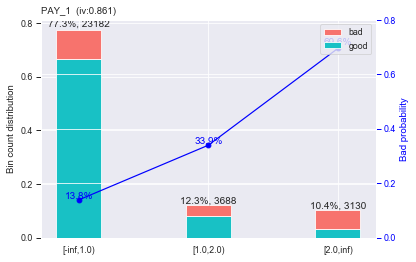

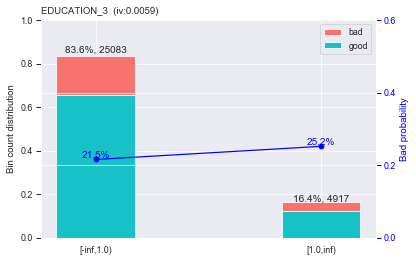

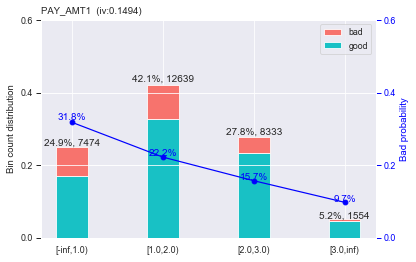

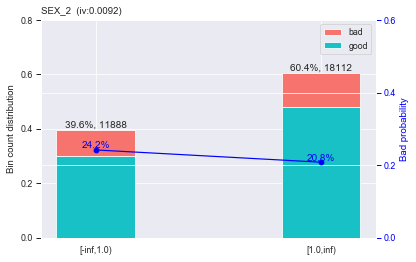

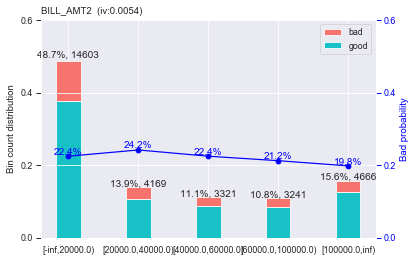

...

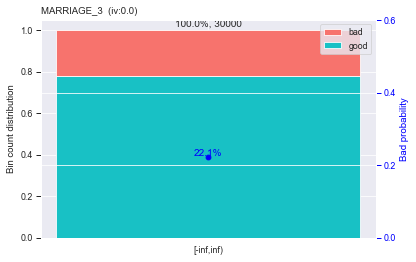

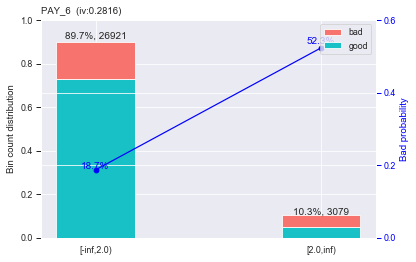

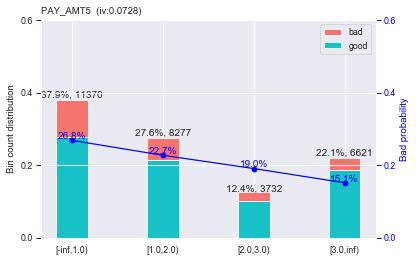

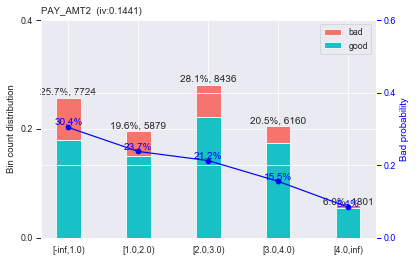

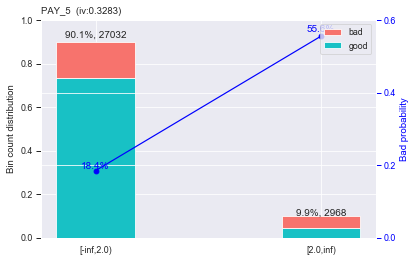

In [53]:
# for normal sampling

bins = sc.woebin(df, y='default', 
                 min_perc_fine_bin = 0.05,     # How many bins to cut initially into
                 min_perc_coarse_bin = 0.05,   # Minimum percentage per final bin
                 stop_limit = 0.1,             # Minimum information value 
                 max_num_bin = 8,              # Maximum number of bins
                 method = 'tree')

sc.woebin_plot(bins)

We could set our threshold to be 0.1 that is any iv value less than 0.1 would be dropped

[INFO] creating woe binning ...
Binning on 32710 rows and 30 columns in 00:00:15


{'PAY_1': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_3': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT1': <Figure size 432x288 with 2 Axes>,
 'SEX_2': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT2': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_1': <Figure size 432x288 with 2 Axes>,
 'LIMIT_BAL': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT6': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT3': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_2': <Figure size 432x288 with 2 Axes>,
 'SEX_1': <Figure size 432x288 with 2 Axes>,
 'MARRIAGE_2': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_1': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT3': <Figure size 432x288 with 2 Axes>,
 'PAY_2': <Figure size 432x288 with 2 Axes>,
 'EDUCATION_4': <Figure size 432x288 with 2 Axes>,
 'PAY_3': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT1': <Figure size 432x288 with 2 Axes>,
 'BILL_AMT4': <Figure size 432x288 with 2 Axes>,
 'PAY_4': <Figure size 432x288 with 2 Axes>,
 'PAY_AMT6': <Figure size 432x288 wi

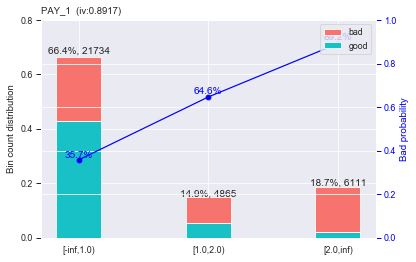

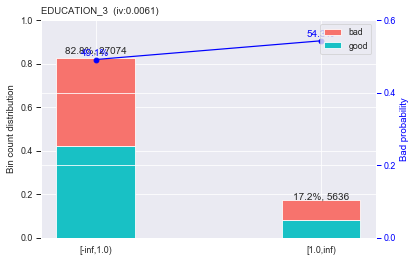

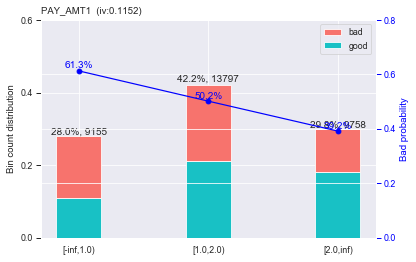

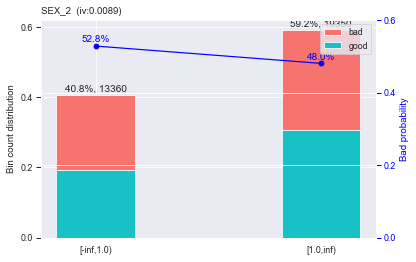

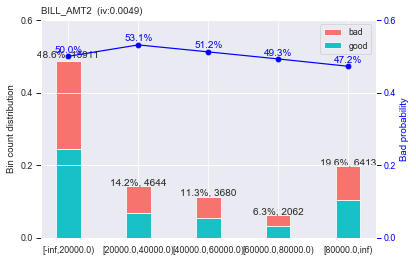

...

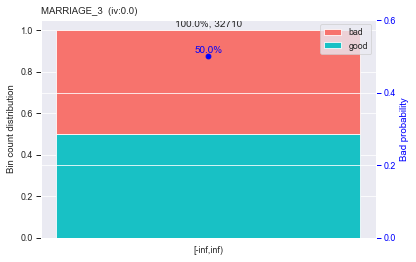

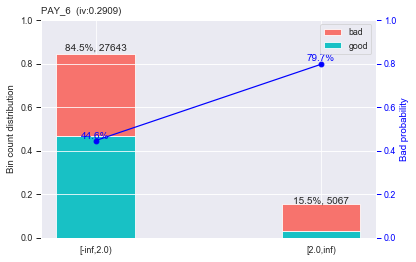

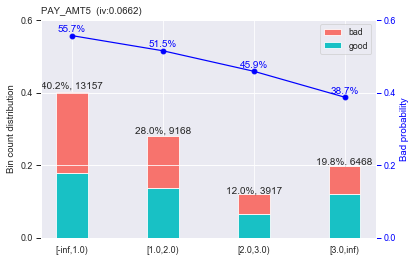

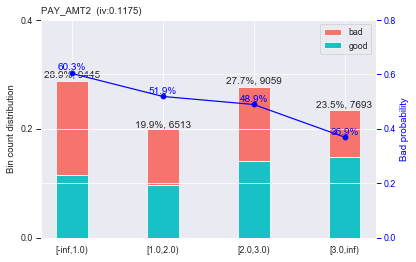

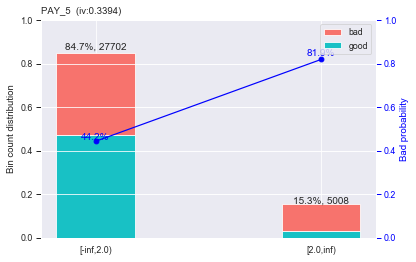

In [54]:
# for upsampling

bins = sc.woebin(df_upsampled, y='default', 
                 min_perc_fine_bin = 0.05,     # How many bins to cut initially into
                 min_perc_coarse_bin = 0.05,   # Minimum percentage per final bin
                 stop_limit = 0.1,             # Minimum information value 
                 max_num_bin = 8,              # Maximum number of bins
                 method = 'tree')

sc.woebin_plot(bins)

In [ ]:
# for downsampling

bins = sc.woebin(df_downsampled, y='default', 
                 min_perc_fine_bin = 0.05,     # How many bins to cut initially into
                 min_perc_coarse_bin = 0.05,   # Minimum percentage per final bin
                 stop_limit = 0.1,             # Minimum information value 
                 max_num_bin = 8,              # Maximum number of bins
                 method = 'tree')

sc.woebin_plot(bins)

However, we did not make use of scorecardpy for feature selection, we made use of the rfecv


From the classifers above, Random forest performed the best on the data that had a reduction in the variance between its datapoints so we worked further with that set of data and the random forest classifier 

Using RFECV for Feature Selection:

In [57]:
xtrain_data = [X_train,df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [y_train,df_upsampled['default'],df_downsampled['default'],y_SMOTE]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling' , 'SMOTE']

for i,j,k in zip(xtrain_data,ytrain_data,name):
    # create pipeline
    rfe = RFECV(estimator=RandomForestClassifier())
    model = RandomForestClassifier()
    pipeline = Pipeline(steps=[('s',rfe),('m',model)])
    # evaluate model
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    n_scores = cross_val_score(pipeline, i, j, scoring='accuracy', cv=cv, n_jobs=-1, error_score='raise')
    # report performance
    print('Accuracy for',k,'using the Randomforestclassifier: %.3f' % (np.mean(n_scores)))
    rfe.fit(i,j)
    # summarize all features
    for y in range(i.shape[1]):
        print('Column for: %d, Selected %s, Rank: %.3f' % (y, rfe.support_[y], rfe.ranking_[y]))

Accuracy for Normal Sampling using the Randomforestclassifier: 0.805
Column for: 0, Selected True, Rank: 1.000
Column for: 1, Selected True, Rank: 1.000
Column for: 2, Selected True, Rank: 1.000
Column for: 3, Selected True, Rank: 1.000
Column for: 4, Selected True, Rank: 1.000
Column for: 5, Selected False, Rank: 12.000
Column for: 6, Selected False, Rank: 4.000
Column for: 7, Selected False, Rank: 11.000
Column for: 8, Selected True, Rank: 1.000
Column for: 9, Selected True, Rank: 1.000
Column for: 10, Selected True, Rank: 1.000
Column for: 11, Selected True, Rank: 1.000
Column for: 12, Selected True, Rank: 1.000
Column for: 13, Selected True, Rank: 1.000
Column for: 14, Selected False, Rank: 3.000
Column for: 15, Selected True, Rank: 1.000
Column for: 16, Selected True, Rank: 1.000
Column for: 17, Selected True, Rank: 1.000
Column for: 18, Selected False, Rank: 2.000
Column for: 19, Selected True, Rank: 1.000
Column for: 20, Selected False, Rank: 9.000
Column for: 21, Selected False

Dropping features for random forest classifier for the four datasets

First we drop the unselected features for the train set for all the four datasets

Next we recreate the test dataset by rejoining X_test and y_test, then drop the unslected features likewise for the four datasets

We the evaluate the performance of the Random forest classifier on the four datsets

Dropping features for the four datasets (training set):

In [106]:
# Normal sampling dataset


df_train = df_train.drop(df_train.iloc[:,[5,6,7,14,18,20,21,22,23,24,25,26,27,28]], axis=1)


In [107]:
# Random Oversampling dataset

df_upsampled = df_upsampled.drop(df_upsampled.iloc[:,[25,28]], axis=1)

In [108]:
# Random Undersampling dataset

df_downsampled = df_downsampled.drop(df_downsampled.iloc[:,[4,6,20,22,23,24,25,26,27,28]], axis=1)

In [109]:
# SMOTE

X_SMOTE = X_SMOTE.drop(X_SMOTE.iloc[:,[4,7,18,24,25,28]], axis=1)

In [110]:
X_SMOTE

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_4,PAY_5,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT6,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,MARRIAGE_1,MARRIAGE_2
0,0.0,32.000000,0.000000,0.000000,0.000000,0.000000,156098.000000,156259.000000,155404.000000,153234.000000,156731.000000,155818.000000,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,0.0,1.000000,0.000000,1.000000
1,0.0,30.000000,0.000000,0.000000,0.000000,2.000000,28383.000000,32903.000000,42283.000000,51539.000000,50583.000000,52588.000000,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,1.0,0.000000,0.000000,1.000000
2,0.0,29.000000,0.000000,0.000000,0.000000,0.000000,73722.000000,75323.000000,64277.000000,45455.000000,42231.000000,42804.000000,0.0,0.0,0.0,0.0,0.0,1.000000,0.000000,1.0,0.000000,0.000000,1.000000
3,0.0,27.000000,0.000000,0.000000,0.000000,0.000000,7286.000000,2160.000000,780.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,0.0,1.000000,1.000000,0.000000
4,0.0,30.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2070.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,1.0,0.000000,0.000000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32705,0.0,28.232846,1.616423,1.616423,1.616423,2.424634,81678.664770,83378.037763,85828.477542,89824.293562,91605.922446,87675.860843,0.0,0.0,0.0,0.0,0.0,0.808211,0.191789,0.0,1.000000,0.808211,0.191789
32706,0.0,28.688363,2.000000,0.000000,0.000000,1.801369,16537.136910,17906.670969,20328.856021,22672.160813,23583.010436,23066.825496,0.0,0.0,0.0,0.0,0.0,0.099315,0.900685,0.0,1.000000,0.099315,0.900685
32707,0.0,61.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,0.0,0.315861,0.000000,1.000000
32708,0.0,31.153084,0.895174,2.685522,1.790348,1.790348,47473.752917,46709.300126,47530.417709,48346.019471,49323.027780,50252.202602,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,0.0,0.895174,0.104826,0.895174


 create the Testing dataframe by remerging X_test and y_test and dropping the unnecessary features for the four datasets

In [123]:
# Normal sampling dataset

df_test = X_test.join(y_test)
df_test


,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3,default
8941,0,30,0,0,0,0,0,0,101832.0,92396.0,84297.0,49681.0,46224.0,44800.0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0
17618,0,32,0,3,2,0,0,0,4927.0,4693.0,3342.0,4844.0,3728.0,2612.0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,1
27895,0,29,0,0,0,0,0,0,167410.0,85536.0,77303.0,60178.0,56436.0,51773.0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0
16103,0,37,0,4,3,2,2,2,3305.0,2870.0,2440.0,2510.0,2641.0,2222.0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0
4422,0,34,0,0,0,0,0,0,24147.0,25750.0,27012.0,27762.0,32126.0,37779.0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27933,0,25,0,0,0,0,0,0,177607.0,177498.0,176081.0,175540.0,142015.0,139162.0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0
26623,0,25,0,0,0,0,0,0,11669.0,12665.0,12905.0,13498.0,13993.0,13854.0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0
21750,0,24,0,0,0,0,0,0,6071.0,0.0,3308.0,2527.0,1076.0,1164.0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0
14888,0,37,1,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0


In [124]:
# We have observed that there is imbalance in the samples from the countplot of the default column above.
# Let's see the distribution of the samples in the TEST dataset

# Separate majority and minority classes
df_majtest = df_test[df_test.default == 0]
df_mintest = df_test[df_test.default == 1]

print(df_test.default.value_counts())

0    7009
1    1991
Name: default, dtype: int64


In [125]:
# Random Oversampling dataset


# Upsample minority class
df_mintest_upsampled = resample(df_mintest, 
                                 replace=True,     # sample with replacement
                                 n_samples = 16355,    # to match majority class
                                 random_state= 42) # reproducible results
# Combine majority class with upsampled minority class
df_upsamptest = pd.concat([df_majtest, df_mintest_upsampled])
# Display new class counts
df_upsamptest.default.value_counts()


1    16355
0     7009
Name: default, dtype: int64

In [126]:
# Random Undersampling dataset


# Random Undersampling
    
# Downsample majority class
df_majtest_downsampled = resample(df_majtest, 
                                 replace=False,    # sample without replacement
                                 n_samples=4645,     # to match minority class
                                 random_state=587) # reproducible results
# Combine minority class with downsampled majority class
df_downsamptest = pd.concat([df_majtest_downsampled, df_mintest])
# Display new class counts
df_downsamptest.default.value_counts()


0    4645
1    1991
Name: default, dtype: int64

In [127]:
# SMOTE


X_SMOTE_test,y_SMOTE_test = SMOTE(random_state=42).fit_sample(X_test,y_test)
X_SMOTE_test_f = pd.DataFrame(data=X_SMOTE_test,columns= list(X_test.columns), dtype=None, copy=False)
y_SMOTE_test_f = pd.Series(y_SMOTE_test)



In [128]:
X_SMOTE_test_f

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,EDUCATION_3,EDUCATION_4,MARRIAGE_1,MARRIAGE_2,MARRIAGE_3
0,0.0,30.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,101832.000000,92396.000000,84297.000000,49681.000000,46224.000000,44800.000000,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.000000,0.000000,1.000000,0.000000,0.0,0.000000,1.000000,0.0
1,0.0,32.000000,0.000000,3.000000,2.000000,0.000000,0.000000,0.0,4927.000000,4693.000000,3342.000000,4844.000000,3728.000000,2612.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,1.000000,0.000000,0.0
2,0.0,29.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,167410.000000,85536.000000,77303.000000,60178.000000,56436.000000,51773.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,0.000000,1.000000,0.0
3,0.0,37.000000,0.000000,4.000000,3.000000,2.000000,2.000000,2.0,3305.000000,2870.000000,2440.000000,2510.000000,2641.000000,2222.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,0.000000,1.000000,0.000000,0.0,1.000000,0.000000,0.0
4,0.0,34.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,24147.000000,25750.000000,27012.000000,27762.000000,32126.000000,37779.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,0.000000,1.000000,0.000000,0.0,1.000000,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14013,0.0,50.105687,0.368562,0.737125,0.737125,0.000000,0.000000,0.0,4811.554415,2396.343931,444.532022,2055.390507,1984.256154,4325.011652,0.0,0.0,0.0,0.0,0.0,0.0,0.368562,0.631438,0.000000,0.631438,0.368562,0.0,1.000000,0.000000,0.0
14014,0.0,22.039988,4.800059,3.840048,2.960012,1.920024,1.920024,2.0,8514.807782,8302.590317,7986.562507,7753.070175,8251.311885,7900.013069,0.0,0.0,0.0,0.0,0.0,0.0,0.039988,0.960012,0.000000,1.000000,0.000000,0.0,0.000000,1.000000,0.0
14015,0.0,42.563690,0.820461,1.640923,2.000000,2.000000,2.000000,2.0,24509.788306,26951.242703,27868.300797,27125.634800,28627.703035,28028.703035,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,0.000000,0.820461,0.179539,0.0,1.000000,0.000000,0.0
14016,0.0,34.415794,2.000000,1.707897,0.000000,0.000000,0.000000,0.0,922.009892,56.960099,56.960099,6592.673318,3934.740481,113.920199,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,0.853948,0.146052,0.0


Dropping unnecessary features in the four new TEST datasets

In [129]:
# Normal sampling dataset

df_test = df_test.drop(df_test.iloc[:,[5,6,7,14,18,20,21,22,23,24,25,26,27,28]], axis=1)

In [130]:
# Random Oversampling

df_upsamptest = df_upsamptest.drop(df_upsamptest.iloc[:,[25,28]], axis=1)

In [131]:
# Random Undersampling

df_downsamptest = df_downsamptest.drop(df_downsamptest.iloc[:,[4,6,20,22,23,24,25,26,27,28]], axis=1)

In [132]:
# SMOTE

X_SMOTE_test_f = X_SMOTE_test_f.drop(X_SMOTE_test_f.iloc[:,[4,7,18,24,25,28]], axis=1)

In [133]:
X_SMOTE_test_f

,LIMIT_BAL,AGE,PAY_1,PAY_2,PAY_4,PAY_5,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT6,SEX_1,SEX_2,EDUCATION_1,EDUCATION_2,MARRIAGE_1,MARRIAGE_2
0,0.0,30.000000,0.000000,0.000000,0.000000,0.000000,101832.000000,92396.000000,84297.000000,49681.000000,46224.000000,44800.000000,0.0,0.0,0.0,0.0,0.0,1.000000,0.000000,0.000000,1.000000,0.000000,1.000000
1,0.0,32.000000,0.000000,3.000000,0.000000,0.000000,4927.000000,4693.000000,3342.000000,4844.000000,3728.000000,2612.000000,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000
2,0.0,29.000000,0.000000,0.000000,0.000000,0.000000,167410.000000,85536.000000,77303.000000,60178.000000,56436.000000,51773.000000,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000
3,0.0,37.000000,0.000000,4.000000,2.000000,2.000000,3305.000000,2870.000000,2440.000000,2510.000000,2641.000000,2222.000000,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000
4,0.0,34.000000,0.000000,0.000000,0.000000,0.000000,24147.000000,25750.000000,27012.000000,27762.000000,32126.000000,37779.000000,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14013,0.0,50.105687,0.368562,0.737125,0.000000,0.000000,4811.554415,2396.343931,444.532022,2055.390507,1984.256154,4325.011652,0.0,0.0,0.0,0.0,0.0,0.368562,0.631438,0.000000,0.631438,1.000000,0.000000
14014,0.0,22.039988,4.800059,3.840048,1.920024,1.920024,8514.807782,8302.590317,7986.562507,7753.070175,8251.311885,7900.013069,0.0,0.0,0.0,0.0,0.0,0.039988,0.960012,0.000000,1.000000,0.000000,1.000000
14015,0.0,42.563690,0.820461,1.640923,2.000000,2.000000,24509.788306,26951.242703,27868.300797,27125.634800,28627.703035,28028.703035,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,0.000000,0.820461,1.000000,0.000000
14016,0.0,34.415794,2.000000,1.707897,0.000000,0.000000,922.009892,56.960099,56.960099,6592.673318,3934.740481,113.920199,0.0,0.0,0.0,0.0,0.0,0.000000,1.000000,1.000000,0.000000,0.853948,0.146052


Evaluating the performance of the Random forest classifier on these datasets

In [134]:

xtrain_data = [df_train.drop('default',axis = 1),df_upsampled.drop('default',axis = 1),df_downsampled.drop('default',axis = 1),X_SMOTE]
ytrain_data = [df_train['default'],df_upsampled['default'],df_downsampled['default'],y_SMOTE]
x_test_data = [df_test.drop('default',axis = 1),df_upsamptest.drop('default',axis = 1),df_downsamptest.drop('default',axis = 1),X_SMOTE_test_f]    
y_test_data = [df_test['default'],df_upsamptest['default'],df_downsamptest['default'],y_SMOTE_test_f]
name = ['Normal Sampling' , 'Over Sampling' , 'Under Sampling', 'Smote']

p = [xtrain_data,ytrain_data,x_test_data,y_test_data,name]


for i,j,x,y,n in zip(*p):
    print('Data is: ',n)
    model_eval(RandomForestClassifier(random_state= 42), i,j,x,y)
    print("_" * 60)

Data is:  Normal Sampling
Overall Train Accuracy 0.9698571428571429
Train AUC Score 0.9967201150206383
Overall Test Accuracy 0.803
Test AUC Score 0.7081265752957793
Classification Report of Test
               precision    recall  f1-score   support

           0       0.83      0.94      0.88      7009
           1       0.61      0.32      0.41      1991

    accuracy                           0.80      9000
   macro avg       0.72      0.63      0.65      9000
weighted avg       0.78      0.80      0.78      9000

K-Fold scores: 0.630 (+/- 0.00007)
____________________________________________________________
Data is:  Over Sampling
Overall Train Accuracy 0.9928156527055946
Train AUC Score 0.9996555707910348
Overall Test Accuracy 0.5537579181646978
Test AUC Score 0.7173574448260368
Classification Report of Test
               precision    recall  f1-score   support

           0       0.39      0.91      0.55      7009
           1       0.91      0.40      0.56     16355

    accura

Now we would view the performances of all the classifers on all the datasets (The dataset with variance reduction and without)

Result for No Hyper Parameter Tuning, No Feature Engineering


In [137]:
dp = pd.read_excel('C:\\Users\\MOFEOLUWA\\Desktop\\AI sat project excel.xlsx','Sheet1')

score_d = pd.DataFrame(dp)
fig =  ff.create_table(score_d)
fig.show()

Result for the  Training Dataset with no Variance and with Variance (Logistic Regression) 


In [138]:
dp = pd.read_excel('C:\\Users\\MOFEOLUWA\\Desktop\\AI sat project excel.xlsx','Sheet2')

score_dp = pd.DataFrame(dp)
fig =  ff.create_table(score_dp)
fig.show()

Result for the  Training Dataset with no Variance and with Variance (Random Forest Classifier) 


In [139]:
dp = pd.read_excel('C:\\Users\\MOFEOLUWA\\Desktop\\AI sat project excel.xlsx','Sheet3')

score_dp = pd.DataFrame(dp)
fig =  ff.create_table(score_dp)
fig.show()

Result for the  Training Dataset with no Variance and with Variance (XGBoost Classifier) 


In [140]:
dp = pd.read_excel('C:\\Users\\MOFEOLUWA\\Desktop\\AI sat project excel.xlsx','Sheet4')

score_dp = pd.DataFrame(dp)
fig =  ff.create_table(score_dp)
fig.show()

Result for the  Training Dataset with no Variance and with Variance (CATBoost Classifier) 

In [141]:
dp = pd.read_excel('C:\\Users\\MOFEOLUWA\\Desktop\\AI sat project excel.xlsx','Sheet5')

score_dp = pd.DataFrame(dp)
fig =  ff.create_table(score_dp)
fig.show()

Results  for the  Training Dataset with no Variance and with Variance (Random Forest Classifier) and the result after Feature Selection.


In [142]:
dp = pd.read_excel('C:\\Users\\MOFEOLUWA\\Desktop\\AI sat project excel.xlsx','Sheet6')

score_dp = pd.DataFrame(dp)
fig =  ff.create_table(score_dp)
fig.show()

# CONCLUSION

Reducing vairiance between data points in a dataset tends to give better result

Hyperparameter tuning for classifiers tends to give better result

From the results above, based on our basis for selecting the best classifier as earlier stated, Random forest Classifier, perfromed the best on the SMOTE dataset with a reduction in variance between data points and the dropping of unncessary features using the RFECV function.

The Overall accuracy score was 0.858

The Test AUC score: 0.904

With a high recall score (for class 1) of 0.78

As seen in the table above.


This would make our clients (The credit card company in Taiwan) happy and confident in our model to give the best result they require, which is to predict if a customer defaults in credit card loan repayment or not.

The model built can without doubt give the best result.